In [19]:
import torch
import dcgan
import data
%matplotlib inline
import matplotlib.pyplot as plt
import torchvision
import numpy as np

image_folder_path = r'D:\Python\gan\emoji_clean'
desired_image_size = (64, 64)

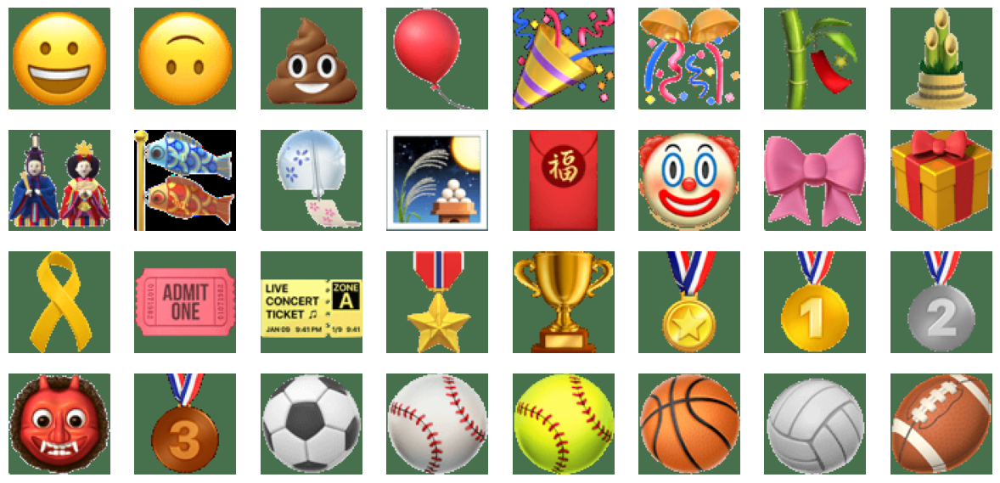

In [20]:
dataset = data.load_dataset(image_folder_path, desired_image_size)
dataloader = data.get_dataloader(dataset, 64)

def show_images(img_folder_path, num_samples=32, cols=8):
    """ 
    Plots some samples from the dataset 
    """
    dataset = torchvision.datasets.ImageFolder(img_folder_path)
    fig = plt.figure(figsize=(15,9))
    fig.patch.set_alpha(0) 
    axs = fig.axes
    for ax in axs:
        ax.remove()
    for i, img in enumerate(dataset):
        if i == num_samples:
            break
        ax = plt.subplot(int(num_samples/cols + 1), cols, i + 1)
        ax.axis("off")
        plt.imshow(img[0])

show_images(image_folder_path)

In [21]:
generator = dcgan.Generator()
discriminator = dcgan.Discriminator()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator = generator.to(device)
discriminator = discriminator.to(device)

In [22]:
# Initialize the ``BCELoss`` function
criterion = torch.nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, 100, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

lr = 0.0002
beta1 = 0.5

# Setup Adam optimizers for both G and D
optimizerD = torch.optim.Adam(generator.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, 0.999))

In [23]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

In [24]:
def save(PATH):
    torch.save(
        {
            'generator_weights' : generator.state_dict(),
            'discriminator_weights' : discriminator.state_dict(),
            'generator_optimizer_weights' : optimizerG.state_dict(),
            'discriminator_optimizer_weights' : optimizerD.state_dict(),
        },
        PATH
    )

def load(PATH):
    checkpoint = torch.load(PATH)
    generator = dcgan.Generator()
    discriminator = dcgan.Discriminator()
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    generator = generator.to(device)
    discriminator = discriminator.to(device)
    optimizerD = torch.optim.Adam(generator.parameters(), lr=lr, betas=(beta1, 0.999))
    optimizerG = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, 0.999))
    generator.load_state_dict(checkpoint['generator_weights'])
    discriminator.load_state_dict(checkpoint['discriminator_weights'])
    optimizerG.load_state_dict(checkpoint['generator_optimizer_weights'])
    optimizerD.load_state_dict(checkpoint['discriminator_optimizer_weights'])

Starting Training Loop...
[1/500][221/222]	Loss_D: 0.6846	Loss_G: 0.8943	D(x): 0.8983	D(G(z)): 0.4271 / 0.4271


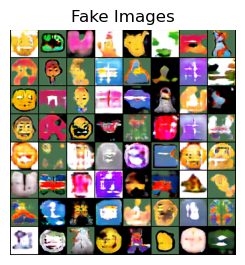

[2/500][221/222]	Loss_D: 0.6941	Loss_G: 0.8980	D(x): 0.8794	D(G(z)): 0.4215 / 0.4215


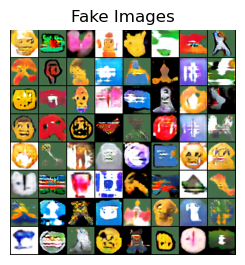

[3/500][221/222]	Loss_D: 0.7324	Loss_G: 0.7413	D(x): 0.9468	D(G(z)): 0.4842 / 0.4842


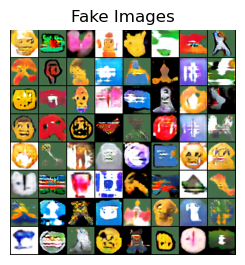

[4/500][221/222]	Loss_D: 0.8509	Loss_G: 0.6197	D(x): 0.9520	D(G(z)): 0.5442 / 0.5442


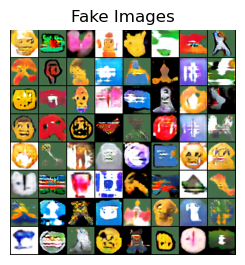

[5/500][221/222]	Loss_D: 0.8268	Loss_G: 0.6403	D(x): 0.9539	D(G(z)): 0.5336 / 0.5336


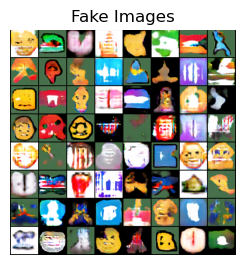

[6/500][221/222]	Loss_D: 0.8578	Loss_G: 0.6389	D(x): 0.9232	D(G(z)): 0.5336 / 0.5336


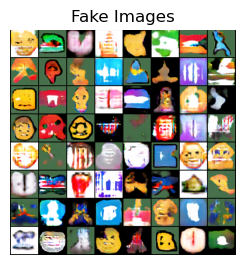

[7/500][221/222]	Loss_D: 1.2452	Loss_G: 0.3790	D(x): 0.9519	D(G(z)): 0.6885 / 0.6885


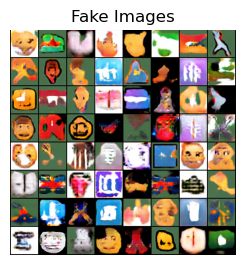

[8/500][221/222]	Loss_D: 0.7829	Loss_G: 0.7346	D(x): 0.9123	D(G(z)): 0.4895 / 0.4895


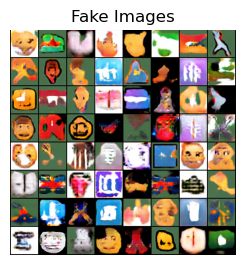

[9/500][221/222]	Loss_D: 0.6488	Loss_G: 0.8403	D(x): 0.9369	D(G(z)): 0.4372 / 0.4372


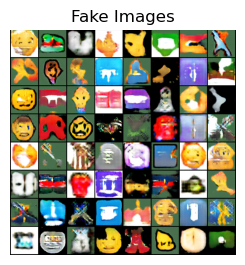

[10/500][221/222]	Loss_D: 1.3521	Loss_G: 0.3224	D(x): 0.9624	D(G(z)): 0.7264 / 0.7264


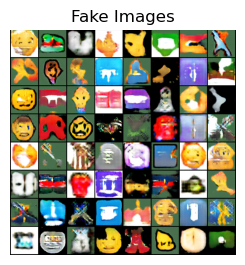

[11/500][221/222]	Loss_D: 0.7332	Loss_G: 0.7391	D(x): 0.9476	D(G(z)): 0.4854 / 0.4854


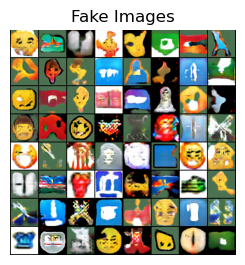

[12/500][221/222]	Loss_D: 0.9381	Loss_G: 0.5342	D(x): 0.9784	D(G(z)): 0.5918 / 0.5918


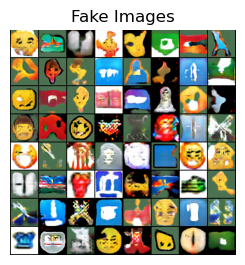

[13/500][221/222]	Loss_D: 0.8150	Loss_G: 0.6568	D(x): 0.9515	D(G(z)): 0.5264 / 0.5264


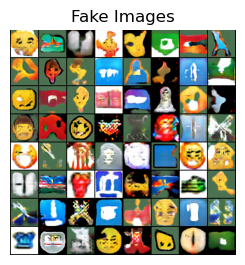

[14/500][221/222]	Loss_D: 0.6377	Loss_G: 0.9011	D(x): 0.9152	D(G(z)): 0.4148 / 0.4148


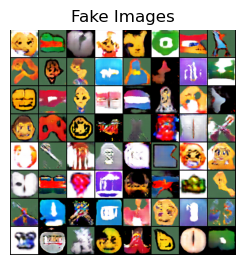

[15/500][221/222]	Loss_D: 0.8200	Loss_G: 0.6502	D(x): 0.9552	D(G(z)): 0.5301 / 0.5301


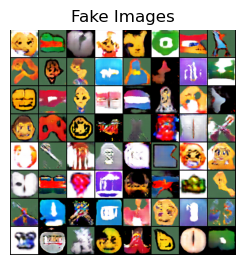

[16/500][221/222]	Loss_D: 0.8956	Loss_G: 0.5661	D(x): 0.9745	D(G(z)): 0.5736 / 0.5736


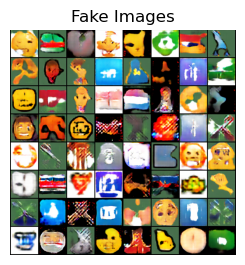

[17/500][221/222]	Loss_D: 0.5243	Loss_G: 1.1585	D(x): 0.8843	D(G(z)): 0.3240 / 0.3240


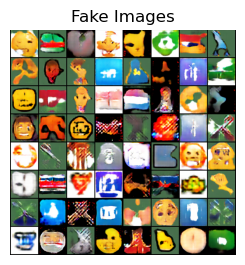

[18/500][221/222]	Loss_D: 0.7795	Loss_G: 0.6830	D(x): 0.9530	D(G(z)): 0.5123 / 0.5123


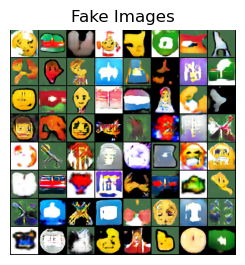

[19/500][221/222]	Loss_D: 0.8696	Loss_G: 0.5928	D(x): 0.9640	D(G(z)): 0.5582 / 0.5582


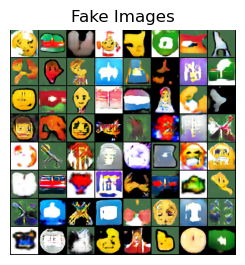

[20/500][221/222]	Loss_D: 0.9298	Loss_G: 0.5476	D(x): 0.9728	D(G(z)): 0.5855 / 0.5855


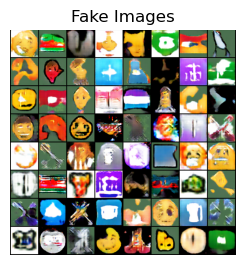

[21/500][221/222]	Loss_D: 0.7130	Loss_G: 0.7418	D(x): 0.9592	D(G(z)): 0.4827 / 0.4827


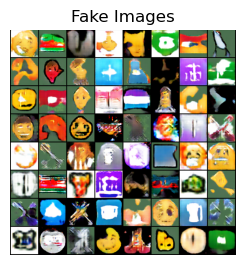

[22/500][221/222]	Loss_D: 0.5747	Loss_G: 0.9023	D(x): 0.9625	D(G(z)): 0.4112 / 0.4112


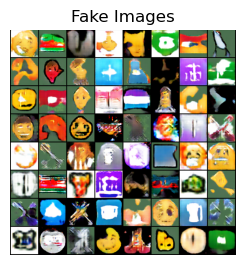

[23/500][221/222]	Loss_D: 0.4661	Loss_G: 1.1502	D(x): 0.9381	D(G(z)): 0.3262 / 0.3262


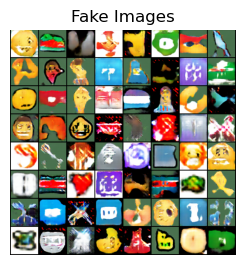

[24/500][221/222]	Loss_D: 0.7513	Loss_G: 0.6937	D(x): 0.9702	D(G(z)): 0.5066 / 0.5066


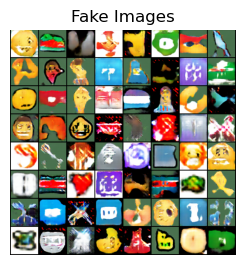

[25/500][221/222]	Loss_D: 0.9657	Loss_G: 0.5397	D(x): 0.9433	D(G(z)): 0.5885 / 0.5885


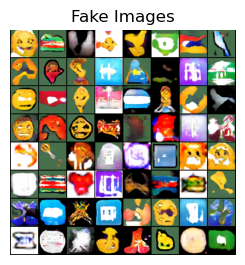

[26/500][221/222]	Loss_D: 0.6567	Loss_G: 0.8429	D(x): 0.9302	D(G(z)): 0.4371 / 0.4371


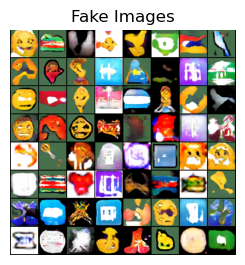

[27/500][221/222]	Loss_D: 0.5824	Loss_G: 0.9308	D(x): 0.9387	D(G(z)): 0.4006 / 0.4006


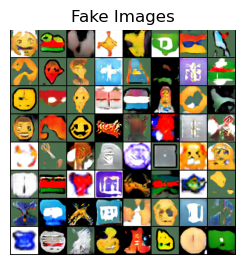

[28/500][221/222]	Loss_D: 0.8419	Loss_G: 0.6295	D(x): 0.9561	D(G(z)): 0.5409 / 0.5409


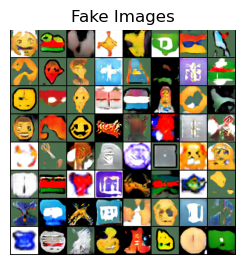

[29/500][221/222]	Loss_D: 0.7824	Loss_G: 0.6545	D(x): 0.9727	D(G(z)): 0.5243 / 0.5243


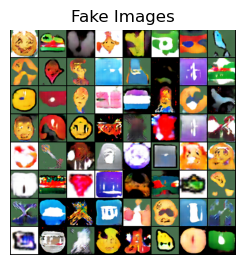

[30/500][221/222]	Loss_D: 0.5483	Loss_G: 0.9180	D(x): 0.9776	D(G(z)): 0.4045 / 0.4045


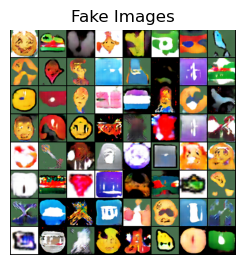

[31/500][221/222]	Loss_D: 0.6744	Loss_G: 0.7807	D(x): 0.9717	D(G(z)): 0.4681 / 0.4681


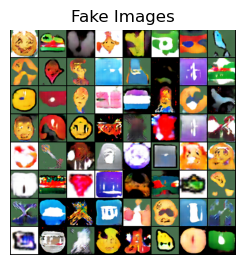

[32/500][221/222]	Loss_D: 0.5057	Loss_G: 1.0787	D(x): 0.9319	D(G(z)): 0.3485 / 0.3485


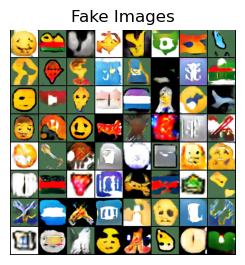

[33/500][221/222]	Loss_D: 0.7882	Loss_G: 0.6658	D(x): 0.9549	D(G(z)): 0.5186 / 0.5186


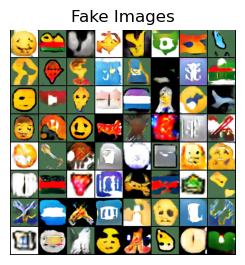

[34/500][221/222]	Loss_D: 0.8777	Loss_G: 0.5684	D(x): 0.9765	D(G(z)): 0.5698 / 0.5698


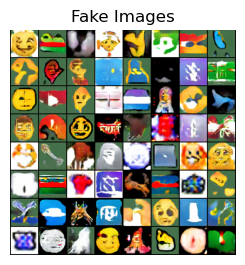

[35/500][221/222]	Loss_D: 0.8853	Loss_G: 0.5728	D(x): 0.9719	D(G(z)): 0.5686 / 0.5686


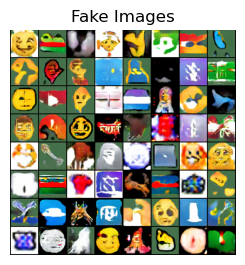

[36/500][221/222]	Loss_D: 0.6394	Loss_G: 0.8032	D(x): 0.9713	D(G(z)): 0.4528 / 0.4528


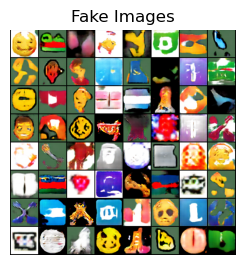

[37/500][221/222]	Loss_D: 0.6360	Loss_G: 0.8631	D(x): 0.9350	D(G(z)): 0.4287 / 0.4287


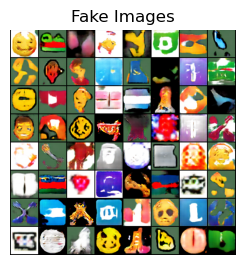

[38/500][221/222]	Loss_D: 0.8242	Loss_G: 0.6373	D(x): 0.9510	D(G(z)): 0.5333 / 0.5333


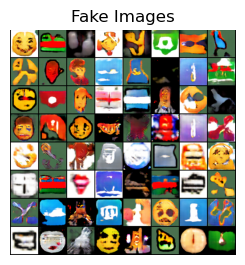

[39/500][221/222]	Loss_D: 0.9655	Loss_G: 0.5142	D(x): 0.9769	D(G(z)): 0.6030 / 0.6030


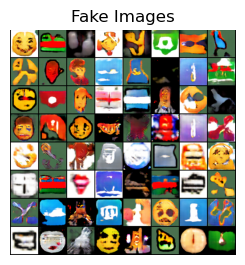

[40/500][221/222]	Loss_D: 1.3571	Loss_G: 0.3193	D(x): 0.9772	D(G(z)): 0.7295 / 0.7295


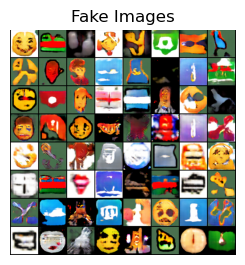

[41/500][221/222]	Loss_D: 0.5816	Loss_G: 0.9031	D(x): 0.9566	D(G(z)): 0.4115 / 0.4115


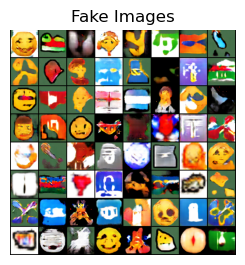

[42/500][221/222]	Loss_D: 1.1049	Loss_G: 0.4328	D(x): 0.9796	D(G(z)): 0.6535 / 0.6535


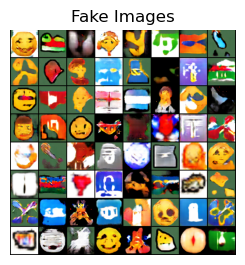

[43/500][221/222]	Loss_D: 0.4632	Loss_G: 1.1031	D(x): 0.9617	D(G(z)): 0.3406 / 0.3406


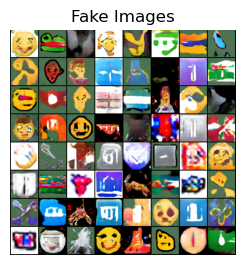

[44/500][221/222]	Loss_D: 0.6470	Loss_G: 0.8049	D(x): 0.9658	D(G(z)): 0.4526 / 0.4526


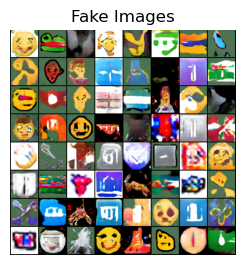

[45/500][221/222]	Loss_D: 0.8460	Loss_G: 0.6226	D(x): 0.9406	D(G(z)): 0.5399 / 0.5399


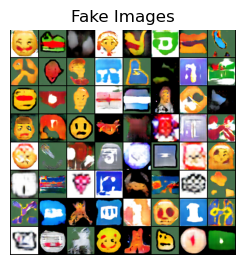

[46/500][221/222]	Loss_D: 0.7992	Loss_G: 0.6416	D(x): 0.9731	D(G(z)): 0.5318 / 0.5318


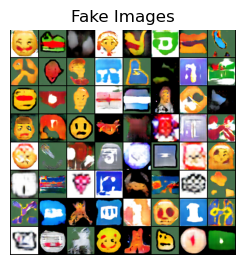

[47/500][221/222]	Loss_D: 0.6465	Loss_G: 0.8062	D(x): 0.9613	D(G(z)): 0.4513 / 0.4513


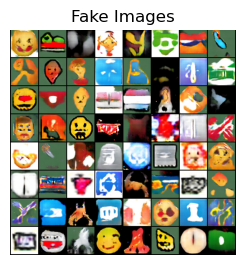

[48/500][221/222]	Loss_D: 0.8265	Loss_G: 0.6292	D(x): 0.9601	D(G(z)): 0.5381 / 0.5381


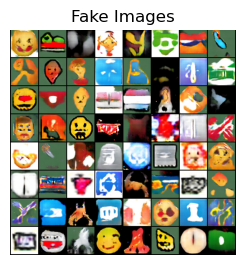

[49/500][221/222]	Loss_D: 0.7915	Loss_G: 0.7045	D(x): 0.9195	D(G(z)): 0.5008 / 0.5008


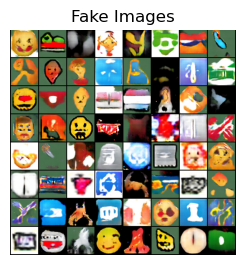

[50/500][221/222]	Loss_D: 0.6240	Loss_G: 0.8466	D(x): 0.9581	D(G(z)): 0.4358 / 0.4358


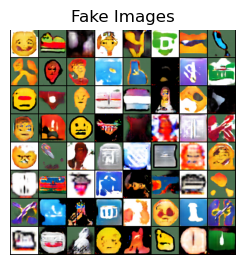

[51/500][221/222]	Loss_D: 0.7755	Loss_G: 0.6607	D(x): 0.9720	D(G(z)): 0.5213 / 0.5213


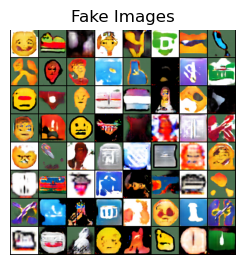

[52/500][221/222]	Loss_D: 0.6345	Loss_G: 0.8248	D(x): 0.9619	D(G(z)): 0.4442 / 0.4442


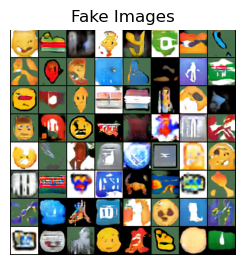

[53/500][221/222]	Loss_D: 1.3032	Loss_G: 0.3307	D(x): 0.9896	D(G(z)): 0.7206 / 0.7206


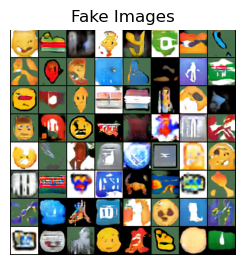

[54/500][221/222]	Loss_D: 1.1438	Loss_G: 0.4011	D(x): 0.9907	D(G(z)): 0.6725 / 0.6725


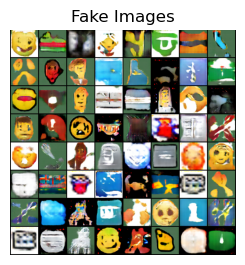

[55/500][221/222]	Loss_D: 0.6141	Loss_G: 0.8468	D(x): 0.9681	D(G(z)): 0.4358 / 0.4358


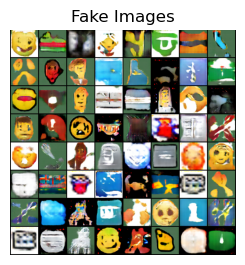

[56/500][221/222]	Loss_D: 0.7113	Loss_G: 0.7270	D(x): 0.9627	D(G(z)): 0.4866 / 0.4866


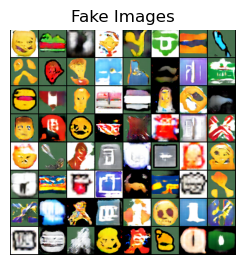

[57/500][221/222]	Loss_D: 0.6938	Loss_G: 0.9095	D(x): 0.8689	D(G(z)): 0.4148 / 0.4148


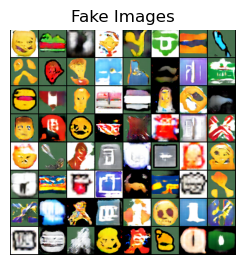

[58/500][221/222]	Loss_D: 0.6063	Loss_G: 0.8859	D(x): 0.9445	D(G(z)): 0.4180 / 0.4180


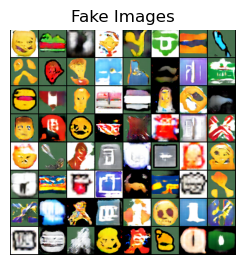

[59/500][221/222]	Loss_D: 0.9074	Loss_G: 0.5456	D(x): 0.9834	D(G(z)): 0.5839 / 0.5839


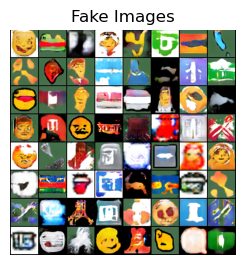

[60/500][221/222]	Loss_D: 0.9244	Loss_G: 0.5315	D(x): 0.9832	D(G(z)): 0.5916 / 0.5916


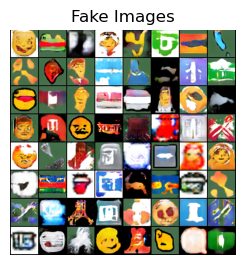

[61/500][221/222]	Loss_D: 0.6938	Loss_G: 0.7535	D(x): 0.9582	D(G(z)): 0.4746 / 0.4746


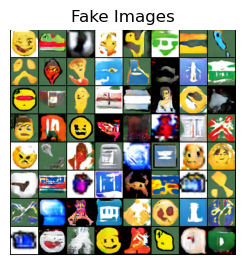

[62/500][221/222]	Loss_D: 0.6604	Loss_G: 0.7635	D(x): 0.9819	D(G(z)): 0.4700 / 0.4700


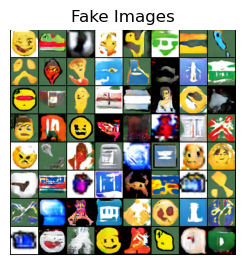

[63/500][221/222]	Loss_D: 0.4287	Loss_G: 1.2859	D(x): 0.9082	D(G(z)): 0.2806 / 0.2806


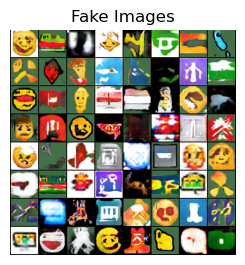

[64/500][221/222]	Loss_D: 0.7213	Loss_G: 0.7159	D(x): 0.9652	D(G(z)): 0.4925 / 0.4925


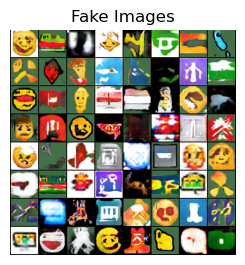

[65/500][221/222]	Loss_D: 0.7820	Loss_G: 0.6913	D(x): 0.9314	D(G(z)): 0.5045 / 0.5045


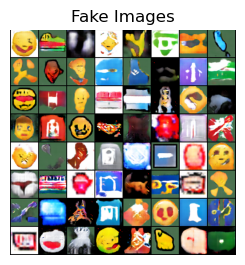

[66/500][221/222]	Loss_D: 0.5890	Loss_G: 0.8920	D(x): 0.9567	D(G(z)): 0.4157 / 0.4157


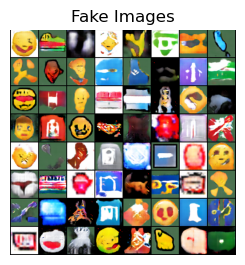

[67/500][221/222]	Loss_D: 0.6591	Loss_G: 0.7750	D(x): 0.9714	D(G(z)): 0.4642 / 0.4642


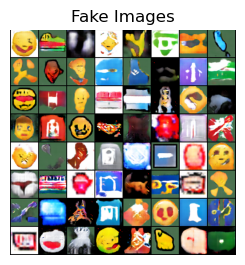

[68/500][221/222]	Loss_D: 0.7643	Loss_G: 0.6622	D(x): 0.9794	D(G(z)): 0.5201 / 0.5201


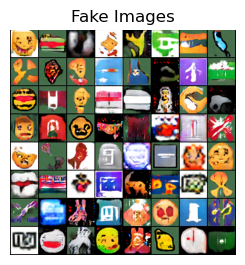

[69/500][221/222]	Loss_D: 0.8226	Loss_G: 0.6054	D(x): 0.9853	D(G(z)): 0.5493 / 0.5493


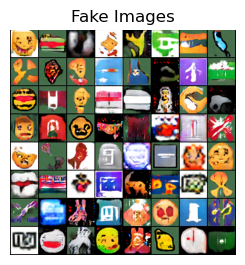

[70/500][221/222]	Loss_D: 1.3723	Loss_G: 0.3089	D(x): 0.9883	D(G(z)): 0.7365 / 0.7365


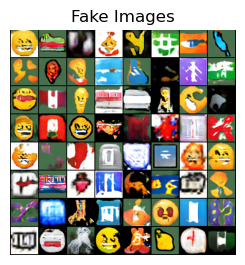

[71/500][221/222]	Loss_D: 0.6668	Loss_G: 0.8252	D(x): 0.9279	D(G(z)): 0.4427 / 0.4427


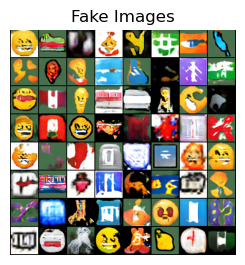

[72/500][221/222]	Loss_D: 0.7029	Loss_G: 0.7252	D(x): 0.9712	D(G(z)): 0.4873 / 0.4873


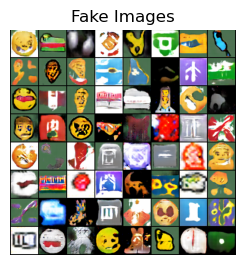

[73/500][221/222]	Loss_D: 0.7925	Loss_G: 0.6572	D(x): 0.9511	D(G(z)): 0.5210 / 0.5210


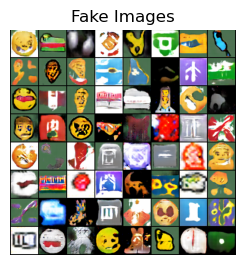

[74/500][221/222]	Loss_D: 0.9274	Loss_G: 0.5447	D(x): 0.9643	D(G(z)): 0.5841 / 0.5841


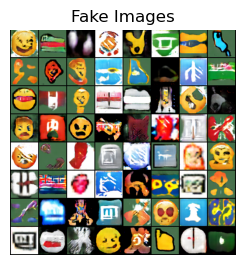

[75/500][221/222]	Loss_D: 0.6611	Loss_G: 0.7603	D(x): 0.9864	D(G(z)): 0.4722 / 0.4722


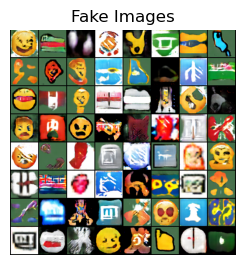

[76/500][221/222]	Loss_D: 0.8448	Loss_G: 0.5749	D(x): 0.9925	D(G(z)): 0.5646 / 0.5646


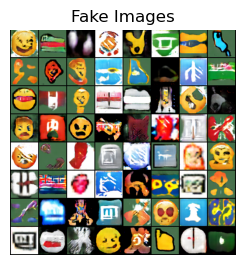

[77/500][221/222]	Loss_D: 1.3422	Loss_G: 0.3166	D(x): 0.9948	D(G(z)): 0.7311 / 0.7311


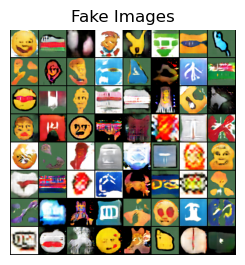

[78/500][221/222]	Loss_D: 0.6249	Loss_G: 0.7992	D(x): 0.9858	D(G(z)): 0.4538 / 0.4538


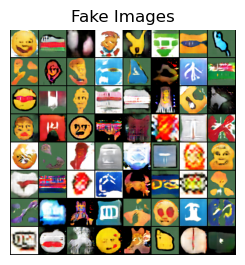

[79/500][221/222]	Loss_D: 0.5920	Loss_G: 0.8142	D(x): 0.9985	D(G(z)): 0.4447 / 0.4447


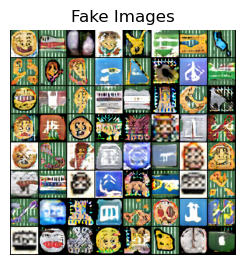

[80/500][221/222]	Loss_D: 0.8423	Loss_G: 0.5651	D(x): 0.9998	D(G(z)): 0.5687 / 0.5687


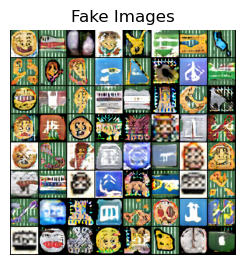

[81/500][221/222]	Loss_D: 0.7208	Loss_G: 0.6677	D(x): 0.9998	D(G(z)): 0.5132 / 0.5132


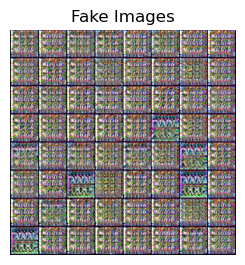

[82/500][221/222]	Loss_D: 0.8114	Loss_G: 0.5884	D(x): 0.9994	D(G(z)): 0.5554 / 0.5554


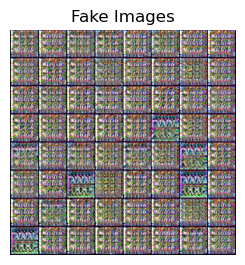

[83/500][221/222]	Loss_D: 0.7190	Loss_G: 0.6687	D(x): 0.9999	D(G(z)): 0.5125 / 0.5125


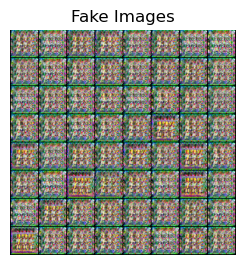

[84/500][221/222]	Loss_D: 0.9933	Loss_G: 0.4632	D(x): 0.9997	D(G(z)): 0.6293 / 0.6293


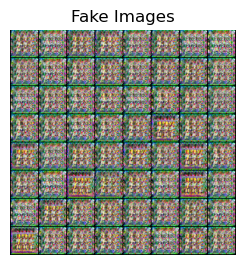

[85/500][221/222]	Loss_D: 0.6954	Loss_G: 0.6912	D(x): 0.9999	D(G(z)): 0.5010 / 0.5010


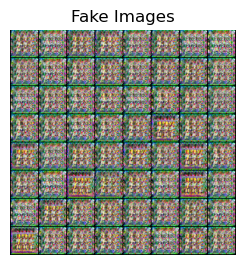

[86/500][221/222]	Loss_D: 0.6518	Loss_G: 0.7366	D(x): 0.9999	D(G(z)): 0.4788 / 0.4788


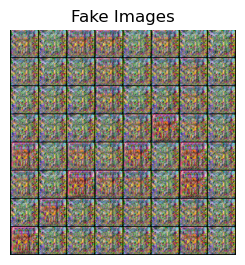

[87/500][221/222]	Loss_D: 0.6600	Loss_G: 0.7280	D(x): 0.9996	D(G(z)): 0.4829 / 0.4829


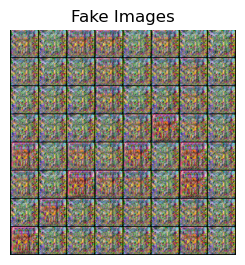

[88/500][221/222]	Loss_D: 0.7204	Loss_G: 0.6671	D(x): 0.9997	D(G(z)): 0.5133 / 0.5133


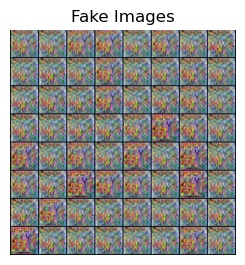

[89/500][221/222]	Loss_D: 0.8392	Loss_G: 0.5659	D(x): 1.0000	D(G(z)): 0.5679 / 0.5679


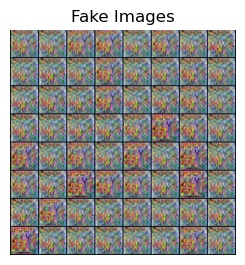

[90/500][221/222]	Loss_D: 0.7095	Loss_G: 0.6777	D(x): 0.9999	D(G(z)): 0.5079 / 0.5079


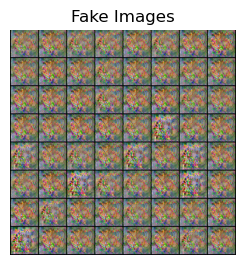

[91/500][221/222]	Loss_D: 0.6589	Loss_G: 0.7297	D(x): 0.9999	D(G(z)): 0.4823 / 0.4823


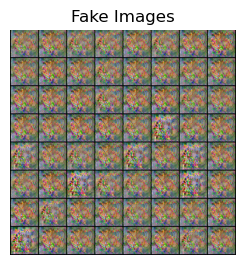

[92/500][221/222]	Loss_D: 0.7458	Loss_G: 0.6434	D(x): 0.9997	D(G(z)): 0.5255 / 0.5255


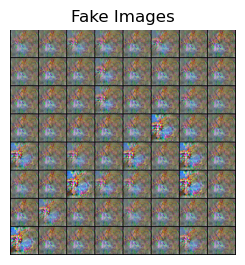

[93/500][221/222]	Loss_D: 0.7121	Loss_G: 0.6750	D(x): 0.9997	D(G(z)): 0.5092 / 0.5092


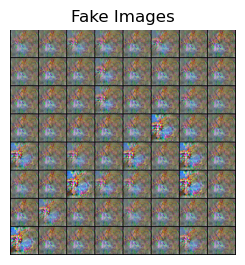

[94/500][221/222]	Loss_D: 0.7467	Loss_G: 0.6431	D(x): 0.9999	D(G(z)): 0.5258 / 0.5258


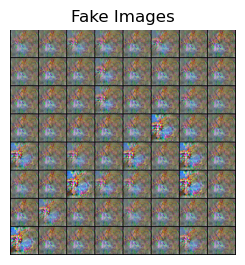

[95/500][221/222]	Loss_D: 0.6884	Loss_G: 0.6997	D(x): 0.9996	D(G(z)): 0.4971 / 0.4971


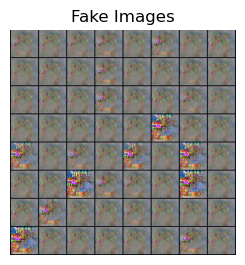

[96/500][221/222]	Loss_D: 0.6607	Loss_G: 0.7411	D(x): 0.9999	D(G(z)): 0.4806 / 0.4806


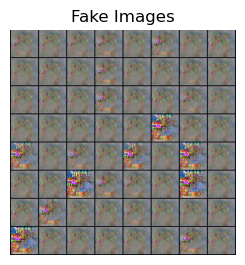

[97/500][221/222]	Loss_D: 0.6984	Loss_G: 0.6895	D(x): 0.9998	D(G(z)): 0.5022 / 0.5022


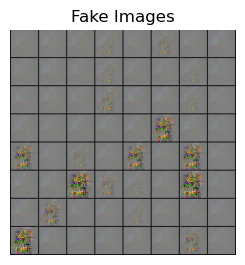

[98/500][221/222]	Loss_D: 0.6103	Loss_G: 0.7929	D(x): 0.9998	D(G(z)): 0.4551 / 0.4551


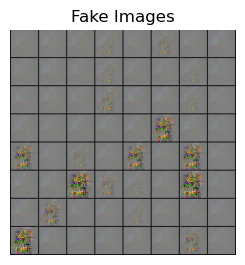

[99/500][221/222]	Loss_D: 0.6678	Loss_G: 0.8318	D(x): 0.9152	D(G(z)): 0.4374 / 0.4374


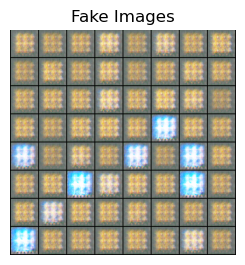

[100/500][221/222]	Loss_D: 0.7223	Loss_G: 0.7247	D(x): 0.9466	D(G(z)): 0.4856 / 0.4856


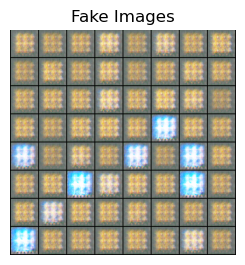

[101/500][221/222]	Loss_D: 0.5208	Loss_G: 1.2294	D(x): 0.8464	D(G(z)): 0.2942 / 0.2942


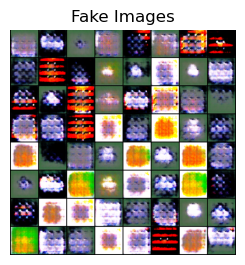

[102/500][221/222]	Loss_D: 0.8477	Loss_G: 0.5746	D(x): 0.9891	D(G(z)): 0.5646 / 0.5646


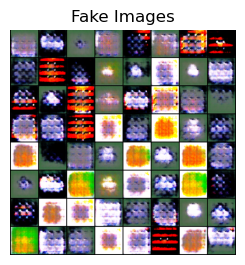

[103/500][221/222]	Loss_D: 0.6452	Loss_G: 0.7759	D(x): 0.9798	D(G(z)): 0.4626 / 0.4626


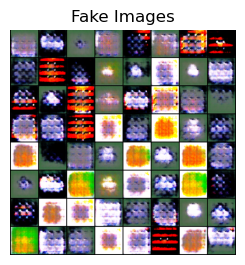

[104/500][221/222]	Loss_D: 0.7950	Loss_G: 0.6173	D(x): 0.9895	D(G(z)): 0.5413 / 0.5413


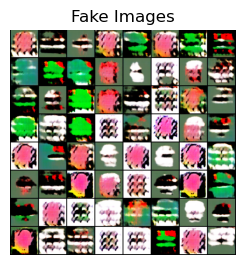

[105/500][221/222]	Loss_D: 0.6771	Loss_G: 0.7321	D(x): 0.9862	D(G(z)): 0.4828 / 0.4828


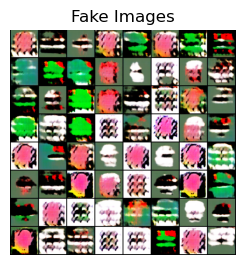

[106/500][221/222]	Loss_D: 0.4484	Loss_G: 1.0617	D(x): 0.9877	D(G(z)): 0.3507 / 0.3507


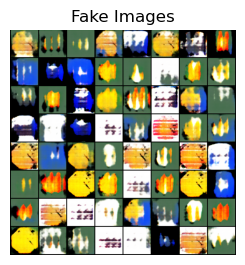

[107/500][221/222]	Loss_D: 0.5773	Loss_G: 0.8655	D(x): 0.9748	D(G(z)): 0.4226 / 0.4226


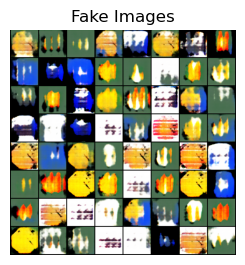

[108/500][221/222]	Loss_D: 0.6083	Loss_G: 0.7997	D(x): 0.9921	D(G(z)): 0.4505 / 0.4505


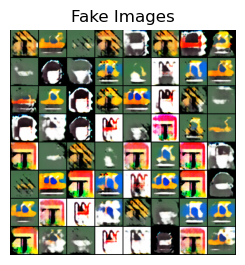

[109/500][221/222]	Loss_D: 0.8254	Loss_G: 0.5944	D(x): 0.9881	D(G(z)): 0.5540 / 0.5540


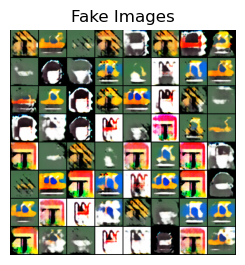

[110/500][221/222]	Loss_D: 0.6654	Loss_G: 0.7256	D(x): 0.9978	D(G(z)): 0.4844 / 0.4844


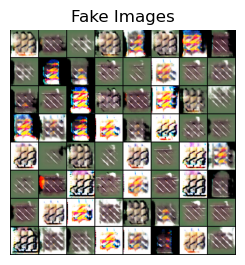

[111/500][221/222]	Loss_D: 0.9207	Loss_G: 0.5173	D(x): 0.9909	D(G(z)): 0.5969 / 0.5969


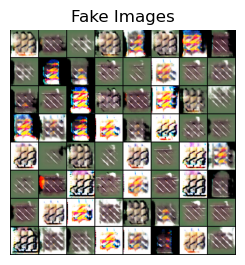

[112/500][221/222]	Loss_D: 0.7544	Loss_G: 0.6412	D(x): 0.9981	D(G(z)): 0.5277 / 0.5277


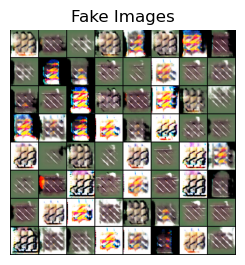

[113/500][221/222]	Loss_D: 0.7924	Loss_G: 0.6095	D(x): 0.9992	D(G(z)): 0.5451 / 0.5451


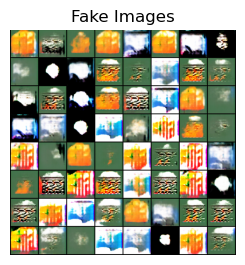

[114/500][221/222]	Loss_D: 0.5316	Loss_G: 0.8990	D(x): 0.9941	D(G(z)): 0.4081 / 0.4081


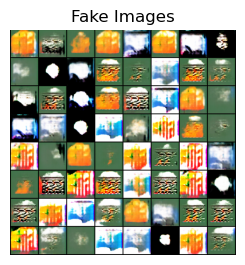

[115/500][221/222]	Loss_D: 0.7483	Loss_G: 0.6421	D(x): 0.9995	D(G(z)): 0.5264 / 0.5264


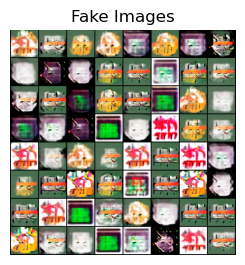

[116/500][221/222]	Loss_D: 0.8179	Loss_G: 0.5899	D(x): 0.9936	D(G(z)): 0.5550 / 0.5550


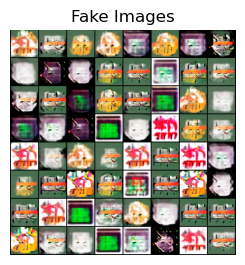

[117/500][221/222]	Loss_D: 0.7439	Loss_G: 0.6508	D(x): 0.9962	D(G(z)): 0.5222 / 0.5222


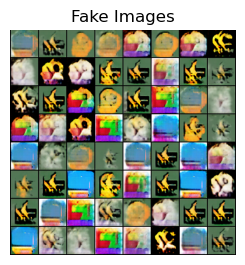

[118/500][221/222]	Loss_D: 0.5827	Loss_G: 0.8221	D(x): 0.9979	D(G(z)): 0.4400 / 0.4400


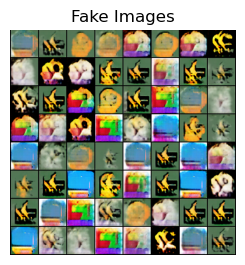

[119/500][221/222]	Loss_D: 0.8208	Loss_G: 0.5879	D(x): 0.9991	D(G(z)): 0.5573 / 0.5573


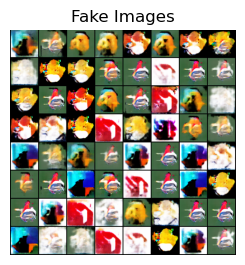

[120/500][221/222]	Loss_D: 0.7600	Loss_G: 0.6324	D(x): 0.9996	D(G(z)): 0.5317 / 0.5317


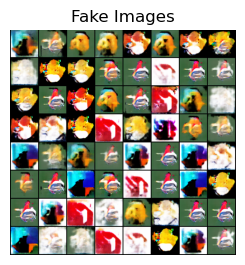

[121/500][221/222]	Loss_D: 0.6065	Loss_G: 0.7904	D(x): 0.9994	D(G(z)): 0.4541 / 0.4541


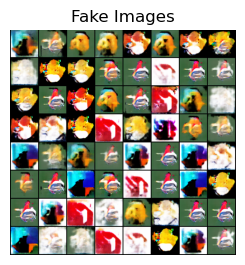

[122/500][221/222]	Loss_D: 0.7999	Loss_G: 0.6006	D(x): 0.9990	D(G(z)): 0.5493 / 0.5493


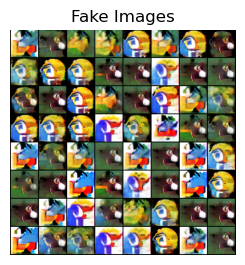

[123/500][221/222]	Loss_D: 0.8194	Loss_G: 0.5817	D(x): 0.9997	D(G(z)): 0.5590 / 0.5590


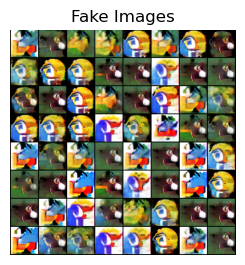

[124/500][221/222]	Loss_D: 1.0697	Loss_G: 0.4447	D(x): 0.9823	D(G(z)): 0.6440 / 0.6440


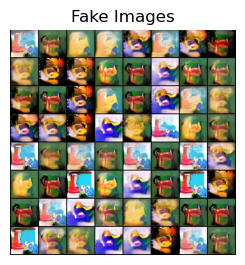

[125/500][221/222]	Loss_D: 1.0935	Loss_G: 0.4150	D(x): 0.9973	D(G(z)): 0.6616 / 0.6616


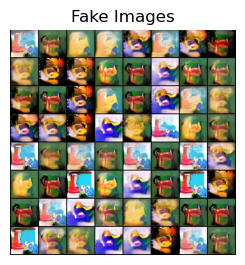

[126/500][221/222]	Loss_D: 0.7099	Loss_G: 0.6856	D(x): 0.9943	D(G(z)): 0.5046 / 0.5046


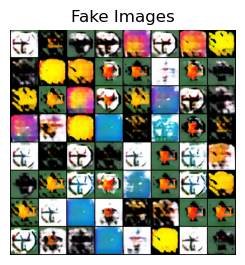

[127/500][221/222]	Loss_D: 0.7910	Loss_G: 0.6146	D(x): 0.9909	D(G(z)): 0.5416 / 0.5416


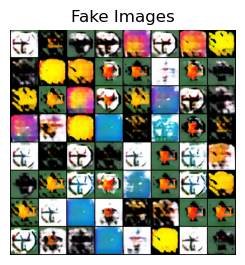

[128/500][221/222]	Loss_D: 0.8209	Loss_G: 0.5866	D(x): 0.9955	D(G(z)): 0.5570 / 0.5570


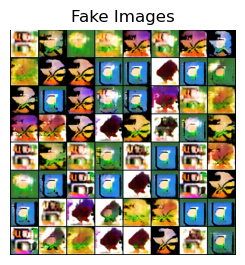

[129/500][221/222]	Loss_D: 0.5726	Loss_G: 0.8405	D(x): 0.9953	D(G(z)): 0.4325 / 0.4325


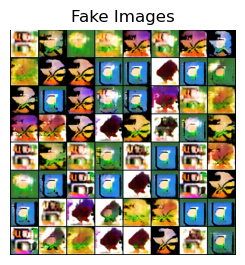

[130/500][221/222]	Loss_D: 0.7995	Loss_G: 0.6012	D(x): 0.9996	D(G(z)): 0.5491 / 0.5491


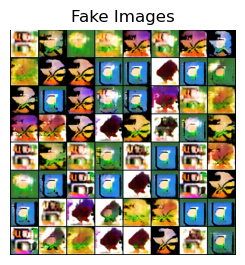

[131/500][221/222]	Loss_D: 0.7292	Loss_G: 0.6603	D(x): 0.9998	D(G(z)): 0.5171 / 0.5171


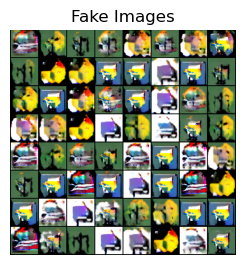

[132/500][221/222]	Loss_D: 0.6130	Loss_G: 0.7823	D(x): 0.9998	D(G(z)): 0.4578 / 0.4578


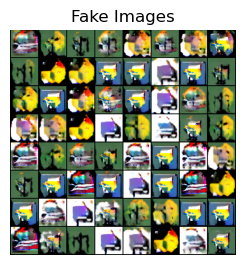

[133/500][221/222]	Loss_D: 0.7518	Loss_G: 0.6403	D(x): 0.9997	D(G(z)): 0.5277 / 0.5277


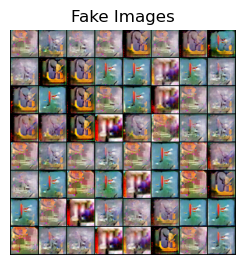

[134/500][221/222]	Loss_D: 0.6925	Loss_G: 0.6942	D(x): 0.9999	D(G(z)): 0.4995 / 0.4995


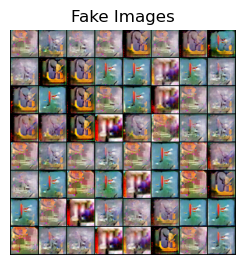

[135/500][221/222]	Loss_D: 0.7347	Loss_G: 0.6545	D(x): 0.9994	D(G(z)): 0.5199 / 0.5199


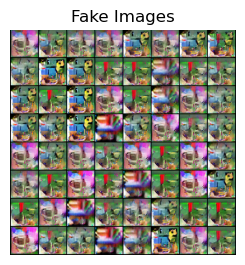

[136/500][221/222]	Loss_D: 0.6983	Loss_G: 0.6889	D(x): 0.9995	D(G(z)): 0.5022 / 0.5022


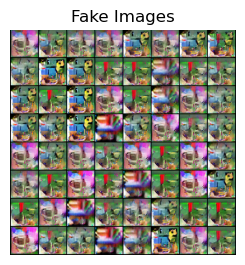

[137/500][221/222]	Loss_D: 0.7985	Loss_G: 0.5982	D(x): 0.9999	D(G(z)): 0.5499 / 0.5499


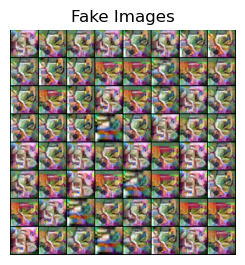

[138/500][221/222]	Loss_D: 0.6882	Loss_G: 0.6983	D(x): 1.0000	D(G(z)): 0.4975 / 0.4975


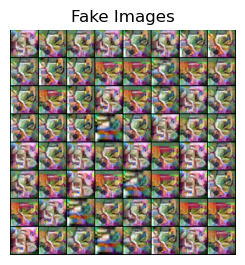

[139/500][221/222]	Loss_D: 0.6326	Loss_G: 0.7578	D(x): 1.0000	D(G(z)): 0.4687 / 0.4687


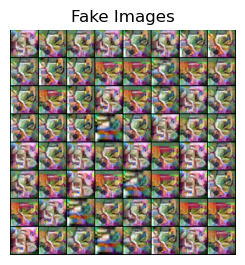

[140/500][221/222]	Loss_D: 0.7953	Loss_G: 0.6006	D(x): 1.0000	D(G(z)): 0.5485 / 0.5485


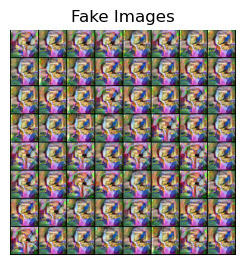

[141/500][221/222]	Loss_D: 0.7650	Loss_G: 0.6263	D(x): 1.0000	D(G(z)): 0.5346 / 0.5346


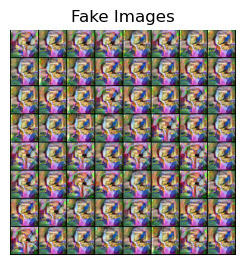

[142/500][221/222]	Loss_D: 0.6824	Loss_G: 0.7044	D(x): 1.0000	D(G(z)): 0.4945 / 0.4945


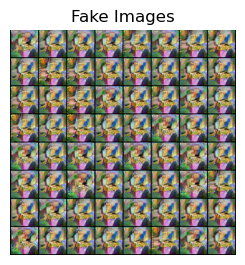

[143/500][221/222]	Loss_D: 0.6674	Loss_G: 0.7197	D(x): 0.9999	D(G(z)): 0.4869 / 0.4869


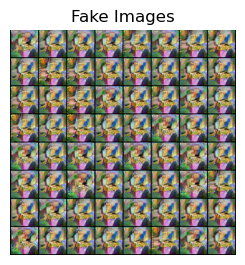

[144/500][221/222]	Loss_D: 0.7245	Loss_G: 0.6629	D(x): 1.0000	D(G(z)): 0.5154 / 0.5154


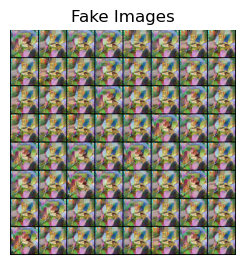

[145/500][221/222]	Loss_D: 0.7161	Loss_G: 0.6708	D(x): 0.9999	D(G(z)): 0.5113 / 0.5113


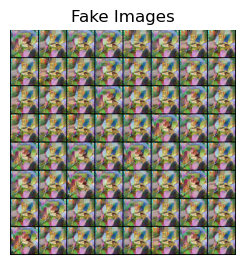

[146/500][221/222]	Loss_D: 0.6787	Loss_G: 0.7080	D(x): 1.0000	D(G(z)): 0.4927 / 0.4927


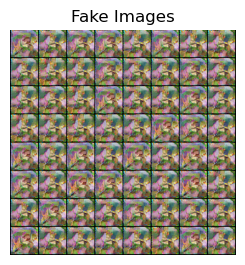

[147/500][221/222]	Loss_D: 0.8236	Loss_G: 0.5782	D(x): 1.0000	D(G(z)): 0.5610 / 0.5610


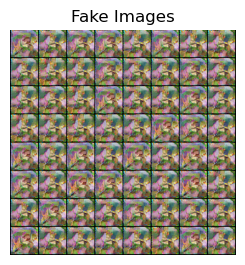

[148/500][221/222]	Loss_D: 0.7464	Loss_G: 0.6427	D(x): 1.0000	D(G(z)): 0.5259 / 0.5259


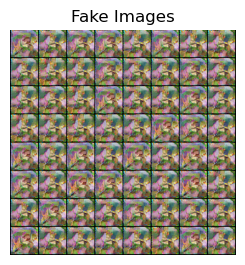

[149/500][221/222]	Loss_D: 0.6206	Loss_G: 0.7715	D(x): 1.0000	D(G(z)): 0.4623 / 0.4623


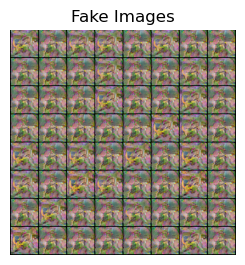

[150/500][221/222]	Loss_D: 0.7649	Loss_G: 0.6264	D(x): 0.9999	D(G(z)): 0.5345 / 0.5345


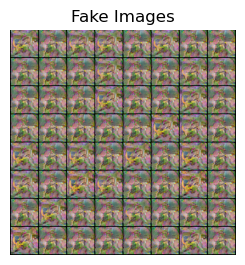

[151/500][221/222]	Loss_D: 0.7493	Loss_G: 0.6401	D(x): 1.0000	D(G(z)): 0.5273 / 0.5273


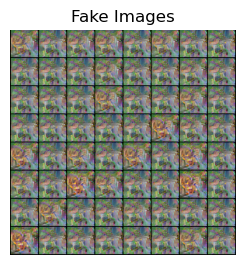

[152/500][221/222]	Loss_D: 0.6815	Loss_G: 0.7050	D(x): 1.0000	D(G(z)): 0.4941 / 0.4941


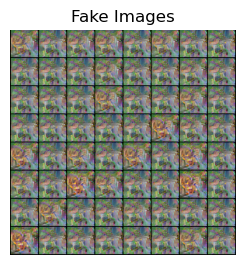

[153/500][221/222]	Loss_D: 0.6309	Loss_G: 0.7595	D(x): 1.0000	D(G(z)): 0.4679 / 0.4679


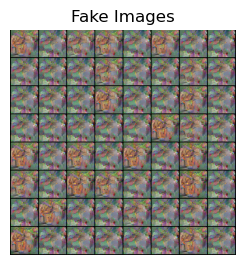

[154/500][221/222]	Loss_D: 0.6362	Loss_G: 0.7536	D(x): 1.0000	D(G(z)): 0.4707 / 0.4707


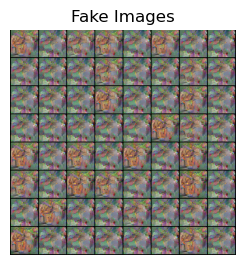

[155/500][221/222]	Loss_D: 0.6888	Loss_G: 0.6975	D(x): 1.0000	D(G(z)): 0.4978 / 0.4978


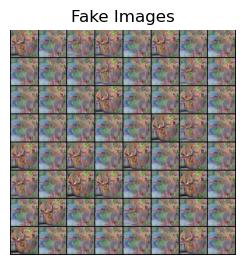

[156/500][221/222]	Loss_D: 0.6651	Loss_G: 0.7222	D(x): 1.0000	D(G(z)): 0.4857 / 0.4857


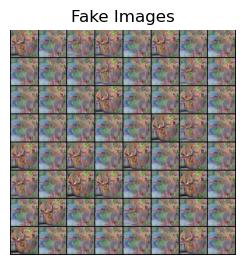

[157/500][221/222]	Loss_D: 0.6746	Loss_G: 0.7120	D(x): 1.0000	D(G(z)): 0.4906 / 0.4906


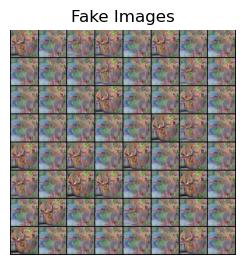

[158/500][221/222]	Loss_D: 0.6486	Loss_G: 0.7399	D(x): 1.0000	D(G(z)): 0.4772 / 0.4772


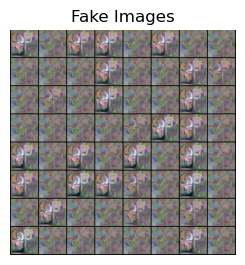

[159/500][221/222]	Loss_D: 0.8111	Loss_G: 0.5877	D(x): 1.0000	D(G(z)): 0.5556 / 0.5556


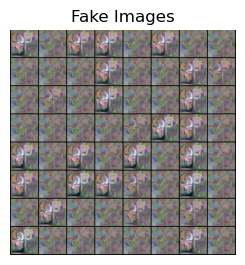

[160/500][221/222]	Loss_D: 0.6969	Loss_G: 0.6894	D(x): 1.0000	D(G(z)): 0.5019 / 0.5019


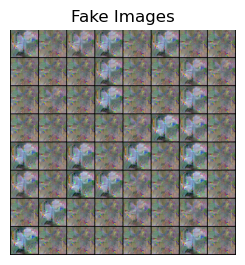

[161/500][221/222]	Loss_D: 0.6462	Loss_G: 0.7425	D(x): 0.9999	D(G(z)): 0.4759 / 0.4759


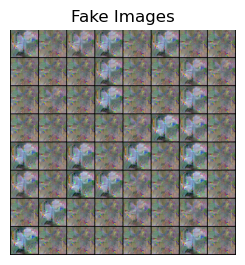

[162/500][221/222]	Loss_D: 0.8047	Loss_G: 0.6143	D(x): 0.9784	D(G(z)): 0.5419 / 0.5419


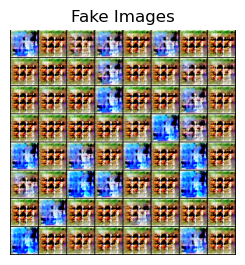

[163/500][221/222]	Loss_D: 0.4907	Loss_G: 1.2467	D(x): 0.8765	D(G(z)): 0.2947 / 0.2947


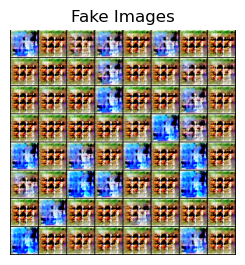

[164/500][221/222]	Loss_D: 0.7501	Loss_G: 0.6623	D(x): 0.9825	D(G(z)): 0.5175 / 0.5175


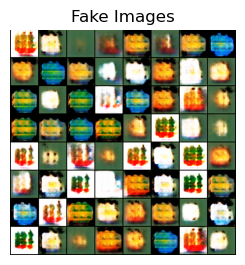

[165/500][221/222]	Loss_D: 0.7667	Loss_G: 0.6437	D(x): 0.9860	D(G(z)): 0.5270 / 0.5270


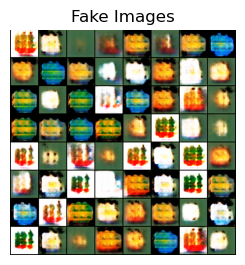

[166/500][221/222]	Loss_D: 0.8127	Loss_G: 0.5926	D(x): 0.9977	D(G(z)): 0.5539 / 0.5539


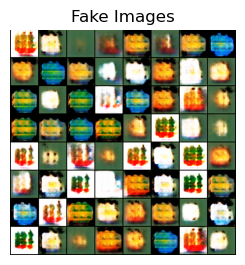

[167/500][221/222]	Loss_D: 0.6286	Loss_G: 0.7718	D(x): 0.9965	D(G(z)): 0.4636 / 0.4636


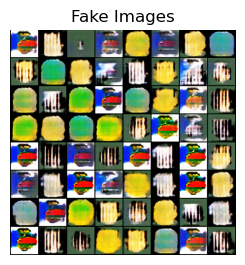

[168/500][221/222]	Loss_D: 0.7397	Loss_G: 0.6597	D(x): 0.9907	D(G(z)): 0.5176 / 0.5176


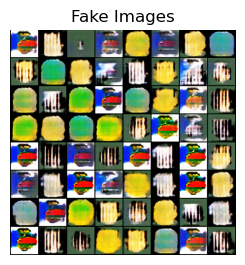

[169/500][221/222]	Loss_D: 0.6706	Loss_G: 0.7225	D(x): 0.9978	D(G(z)): 0.4865 / 0.4865


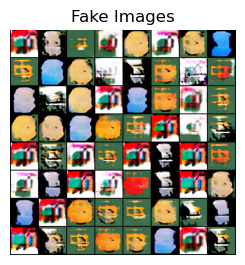

[170/500][221/222]	Loss_D: 0.7645	Loss_G: 0.6372	D(x): 0.9908	D(G(z)): 0.5294 / 0.5294


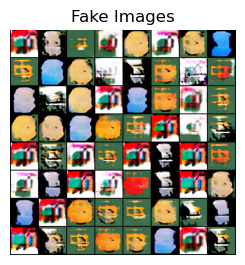

[171/500][221/222]	Loss_D: 0.5188	Loss_G: 0.9331	D(x): 0.9870	D(G(z)): 0.3956 / 0.3956


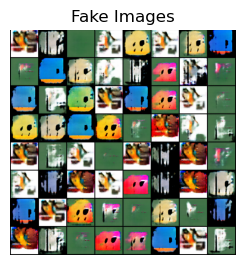

[172/500][221/222]	Loss_D: 0.6894	Loss_G: 0.7028	D(x): 0.9981	D(G(z)): 0.4962 / 0.4962


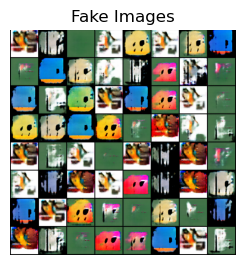

[173/500][221/222]	Loss_D: 0.6606	Loss_G: 0.7304	D(x): 0.9981	D(G(z)): 0.4821 / 0.4821


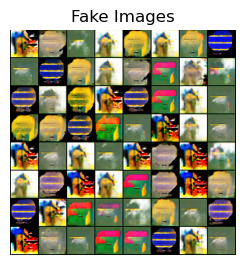

[174/500][221/222]	Loss_D: 0.8073	Loss_G: 0.6226	D(x): 0.9647	D(G(z)): 0.5370 / 0.5370


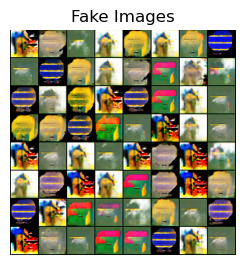

[175/500][221/222]	Loss_D: 0.7659	Loss_G: 0.6265	D(x): 0.9996	D(G(z)): 0.5346 / 0.5346


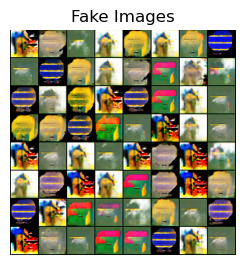

[176/500][221/222]	Loss_D: 0.9669	Loss_G: 0.4889	D(x): 0.9935	D(G(z)): 0.6148 / 0.6148


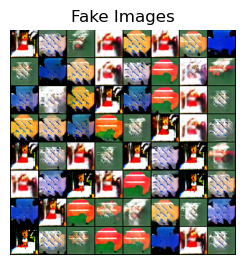

[177/500][221/222]	Loss_D: 0.6582	Loss_G: 0.7328	D(x): 0.9981	D(G(z)): 0.4809 / 0.4809


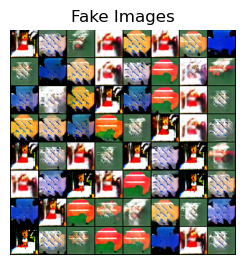

[178/500][221/222]	Loss_D: 0.7428	Loss_G: 0.6475	D(x): 0.9988	D(G(z)): 0.5235 / 0.5235


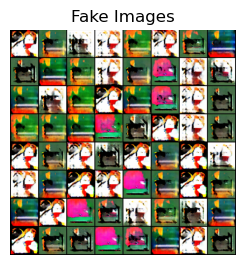

[179/500][221/222]	Loss_D: 0.8479	Loss_G: 0.5607	D(x): 0.9996	D(G(z)): 0.5711 / 0.5711


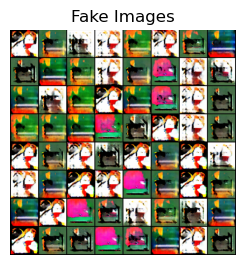

[180/500][221/222]	Loss_D: 0.6519	Loss_G: 0.7375	D(x): 0.9994	D(G(z)): 0.4785 / 0.4785


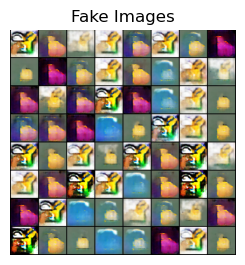

[181/500][221/222]	Loss_D: 0.7113	Loss_G: 0.6770	D(x): 0.9990	D(G(z)): 0.5083 / 0.5083


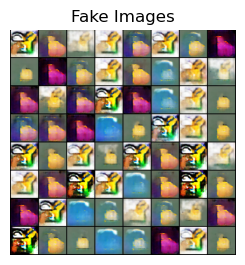

[182/500][221/222]	Loss_D: 1.1058	Loss_G: 0.5591	D(x): 0.8236	D(G(z)): 0.5805 / 0.5805


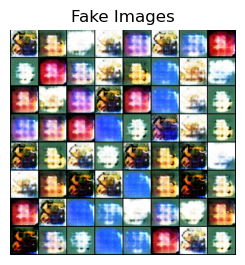

[183/500][221/222]	Loss_D: 0.7844	Loss_G: 0.6665	D(x): 0.9428	D(G(z)): 0.5146 / 0.5146


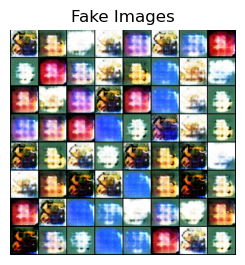

[184/500][221/222]	Loss_D: 0.5364	Loss_G: 0.8919	D(x): 0.9962	D(G(z)): 0.4116 / 0.4116


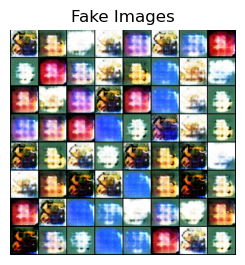

[185/500][221/222]	Loss_D: 1.6193	Loss_G: 0.2576	D(x): 0.8756	D(G(z)): 0.7731 / 0.7731


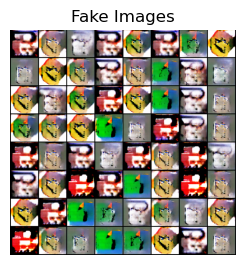

[186/500][221/222]	Loss_D: 0.7523	Loss_G: 0.6456	D(x): 0.9982	D(G(z)): 0.5256 / 0.5256


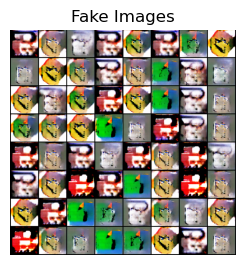

[187/500][221/222]	Loss_D: 0.7450	Loss_G: 0.6488	D(x): 0.9993	D(G(z)): 0.5238 / 0.5238


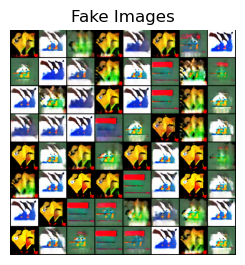

[188/500][221/222]	Loss_D: 0.5587	Loss_G: 0.8547	D(x): 0.9981	D(G(z)): 0.4263 / 0.4263


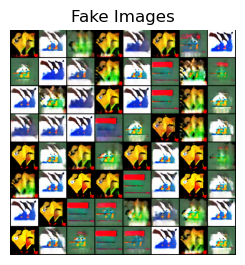

[189/500][221/222]	Loss_D: 0.8029	Loss_G: 0.5980	D(x): 0.9994	D(G(z)): 0.5507 / 0.5507


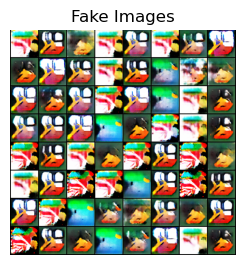

[190/500][221/222]	Loss_D: 0.7037	Loss_G: 0.6832	D(x): 0.9998	D(G(z)): 0.5051 / 0.5051


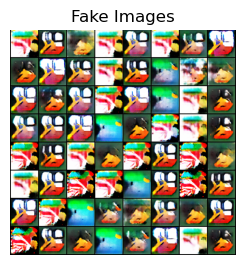

[191/500][221/222]	Loss_D: 0.8552	Loss_G: 0.5696	D(x): 0.9991	D(G(z)): 0.5692 / 0.5692


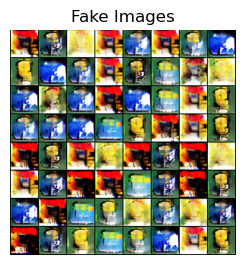

[192/500][221/222]	Loss_D: 0.5259	Loss_G: 0.9210	D(x): 0.9833	D(G(z)): 0.3986 / 0.3986


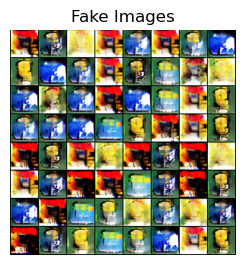

[193/500][221/222]	Loss_D: 0.4691	Loss_G: 0.9971	D(x): 0.9992	D(G(z)): 0.3723 / 0.3723


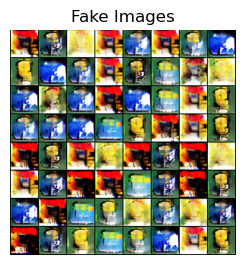

[194/500][221/222]	Loss_D: 0.6146	Loss_G: 0.7789	D(x): 0.9998	D(G(z)): 0.4590 / 0.4590


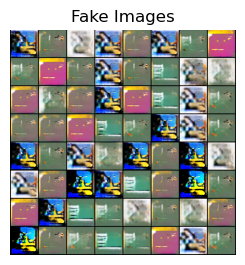

[195/500][221/222]	Loss_D: 0.6798	Loss_G: 0.7070	D(x): 0.9998	D(G(z)): 0.4932 / 0.4932


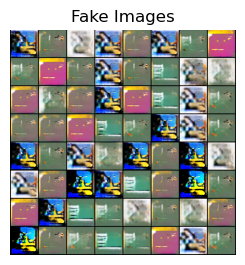

[196/500][221/222]	Loss_D: 0.6988	Loss_G: 0.6885	D(x): 0.9994	D(G(z)): 0.5024 / 0.5024


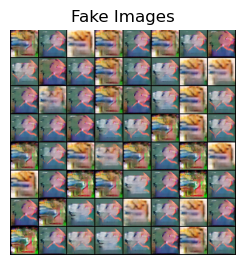

[197/500][221/222]	Loss_D: 0.6663	Loss_G: 0.7210	D(x): 0.9999	D(G(z)): 0.4863 / 0.4863


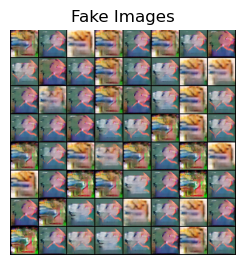

[198/500][221/222]	Loss_D: 0.6622	Loss_G: 0.7256	D(x): 0.9999	D(G(z)): 0.4841 / 0.4841


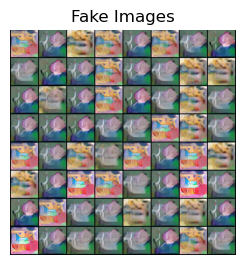

[199/500][221/222]	Loss_D: 0.6798	Loss_G: 0.7072	D(x): 0.9999	D(G(z)): 0.4932 / 0.4932


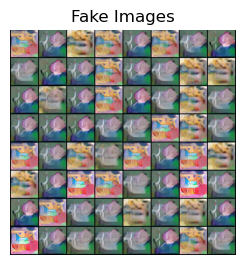

[200/500][221/222]	Loss_D: 0.6724	Loss_G: 0.7155	D(x): 0.9998	D(G(z)): 0.4892 / 0.4892


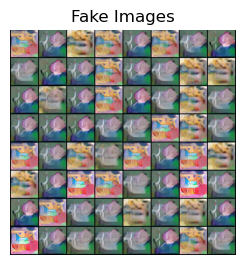

[201/500][221/222]	Loss_D: 0.7209	Loss_G: 0.6665	D(x): 0.9999	D(G(z)): 0.5136 / 0.5136


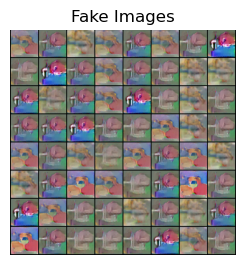

[202/500][221/222]	Loss_D: 0.7199	Loss_G: 0.6676	D(x): 0.9999	D(G(z)): 0.5131 / 0.5131


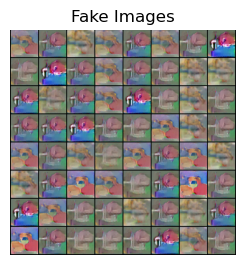

[203/500][221/222]	Loss_D: 0.6701	Loss_G: 0.7175	D(x): 0.9999	D(G(z)): 0.4881 / 0.4881


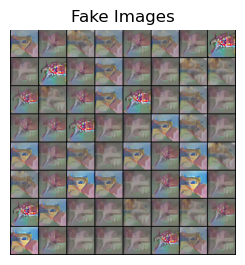

[204/500][221/222]	Loss_D: 0.6855	Loss_G: 0.7010	D(x): 0.9999	D(G(z)): 0.4961 / 0.4961


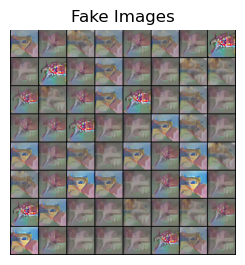

[205/500][221/222]	Loss_D: 0.7089	Loss_G: 0.6777	D(x): 1.0000	D(G(z)): 0.5078 / 0.5078


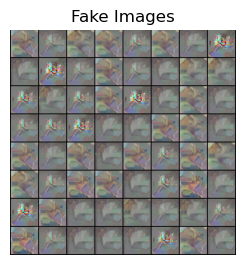

[206/500][221/222]	Loss_D: 0.6925	Loss_G: 0.6940	D(x): 1.0000	D(G(z)): 0.4996 / 0.4996


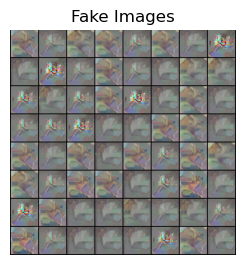

[207/500][221/222]	Loss_D: 0.7188	Loss_G: 0.6684	D(x): 1.0000	D(G(z)): 0.5126 / 0.5126


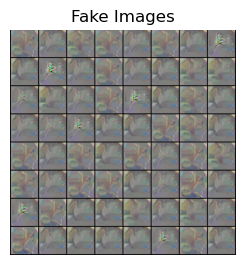

[208/500][221/222]	Loss_D: 0.8099	Loss_G: 0.5888	D(x): 1.0000	D(G(z)): 0.5551 / 0.5551


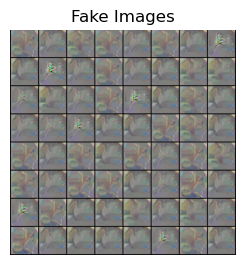

[209/500][221/222]	Loss_D: 0.7172	Loss_G: 0.6697	D(x): 1.0000	D(G(z)): 0.5119 / 0.5119


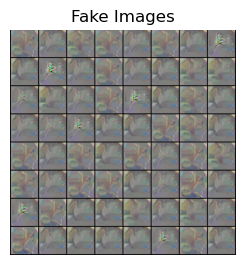

[210/500][221/222]	Loss_D: 0.6126	Loss_G: 0.7809	D(x): 0.9999	D(G(z)): 0.4580 / 0.4580


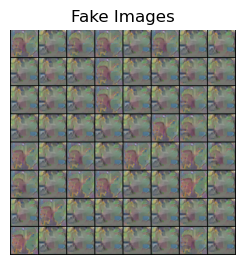

[211/500][221/222]	Loss_D: 0.6966	Loss_G: 0.6897	D(x): 1.0000	D(G(z)): 0.5017 / 0.5017


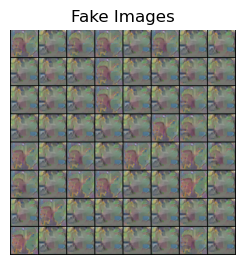

[212/500][221/222]	Loss_D: 0.6978	Loss_G: 0.6886	D(x): 1.0000	D(G(z)): 0.5023 / 0.5023


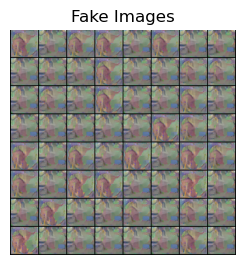

[213/500][221/222]	Loss_D: 0.7302	Loss_G: 0.6579	D(x): 1.0000	D(G(z)): 0.5180 / 0.5180


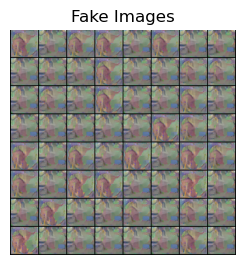

[214/500][221/222]	Loss_D: 0.6500	Loss_G: 0.7383	D(x): 1.0000	D(G(z)): 0.4779 / 0.4779


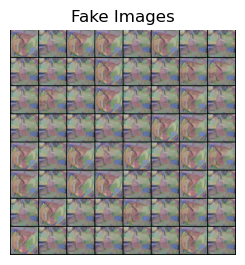

[215/500][221/222]	Loss_D: 0.7033	Loss_G: 0.6831	D(x): 1.0000	D(G(z)): 0.5050 / 0.5050


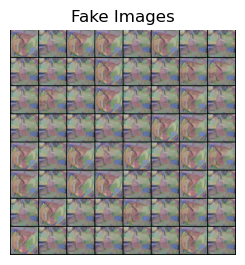

[216/500][221/222]	Loss_D: 0.7357	Loss_G: 0.6524	D(x): 1.0000	D(G(z)): 0.5208 / 0.5208


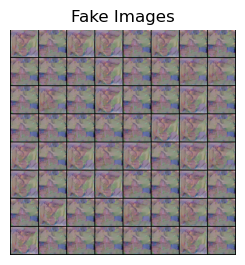

[217/500][221/222]	Loss_D: 0.7729	Loss_G: 0.6213	D(x): 1.0000	D(G(z)): 0.5378 / 0.5378


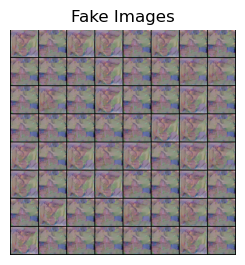

[218/500][221/222]	Loss_D: 0.6538	Loss_G: 0.7344	D(x): 1.0000	D(G(z)): 0.4799 / 0.4799


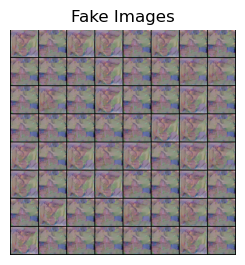

[219/500][221/222]	Loss_D: 0.6879	Loss_G: 0.6985	D(x): 1.0000	D(G(z)): 0.4973 / 0.4973


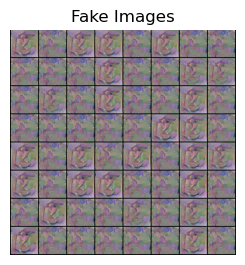

[220/500][221/222]	Loss_D: 0.7144	Loss_G: 0.6723	D(x): 1.0000	D(G(z)): 0.5105 / 0.5105


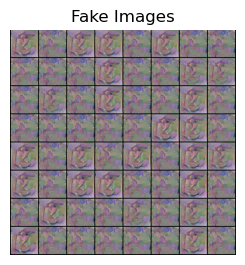

[221/500][221/222]	Loss_D: 0.6693	Loss_G: 0.7176	D(x): 1.0000	D(G(z)): 0.4879 / 0.4879


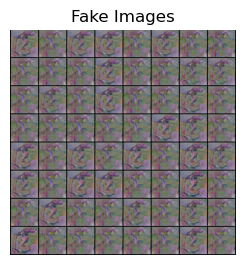

[222/500][221/222]	Loss_D: 0.6175	Loss_G: 0.7750	D(x): 1.0000	D(G(z)): 0.4607 / 0.4607


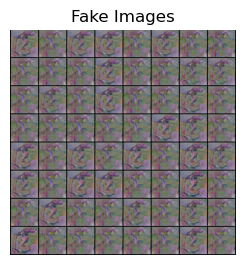

[223/500][221/222]	Loss_D: 0.9741	Loss_G: 0.5544	D(x): 0.9031	D(G(z)): 0.5772 / 0.5772


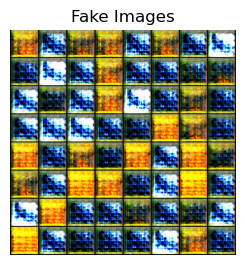

[224/500][221/222]	Loss_D: 0.9809	Loss_G: 0.6354	D(x): 0.8182	D(G(z)): 0.5342 / 0.5342


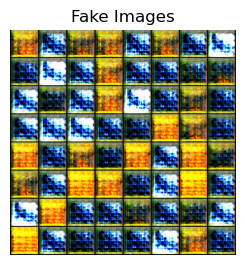

[225/500][221/222]	Loss_D: 0.7653	Loss_G: 0.6396	D(x): 0.9931	D(G(z)): 0.5294 / 0.5294


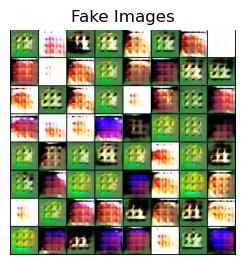

[226/500][221/222]	Loss_D: 0.6841	Loss_G: 0.7135	D(x): 0.9940	D(G(z)): 0.4912 / 0.4912


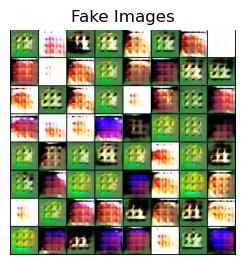

[227/500][221/222]	Loss_D: 0.8052	Loss_G: 0.6346	D(x): 0.9616	D(G(z)): 0.5325 / 0.5325


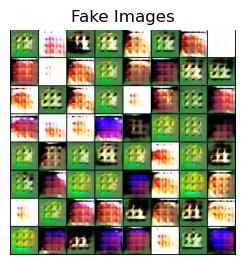

[228/500][221/222]	Loss_D: 0.7487	Loss_G: 0.6436	D(x): 0.9990	D(G(z)): 0.5259 / 0.5259


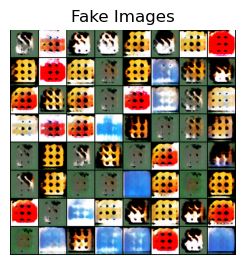

[229/500][221/222]	Loss_D: 0.8288	Loss_G: 0.5896	D(x): 0.9860	D(G(z)): 0.5557 / 0.5557


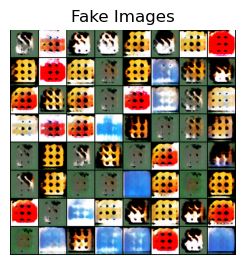

[230/500][221/222]	Loss_D: 0.7785	Loss_G: 0.6269	D(x): 0.9922	D(G(z)): 0.5356 / 0.5356


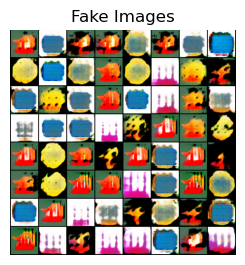

[231/500][221/222]	Loss_D: 0.7657	Loss_G: 0.6299	D(x): 0.9990	D(G(z)): 0.5335 / 0.5335


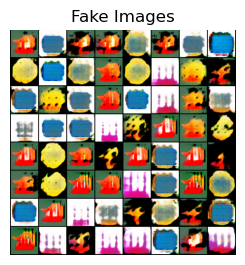

[232/500][221/222]	Loss_D: 0.7140	Loss_G: 0.6759	D(x): 0.9992	D(G(z)): 0.5093 / 0.5093


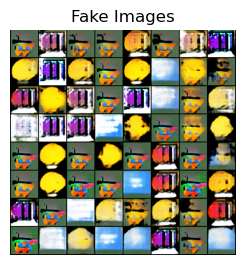

[233/500][221/222]	Loss_D: 0.7828	Loss_G: 0.6206	D(x): 0.9915	D(G(z)): 0.5382 / 0.5382


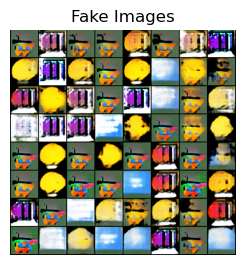

[234/500][221/222]	Loss_D: 0.6458	Loss_G: 0.8402	D(x): 0.9272	D(G(z)): 0.4330 / 0.4330


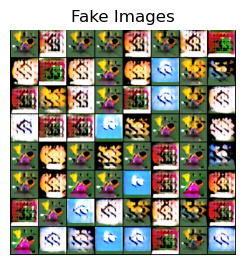

[235/500][221/222]	Loss_D: 0.7417	Loss_G: 0.6503	D(x): 0.9988	D(G(z)): 0.5225 / 0.5225


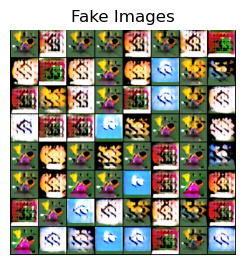

[236/500][221/222]	Loss_D: 0.6153	Loss_G: 0.7853	D(x): 0.9948	D(G(z)): 0.4564 / 0.4564


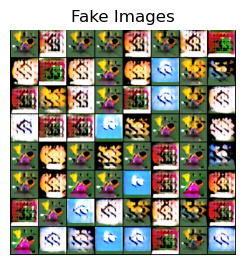

[237/500][221/222]	Loss_D: 0.6533	Loss_G: 0.7437	D(x): 0.9971	D(G(z)): 0.4768 / 0.4768


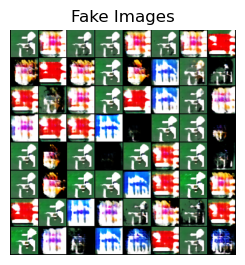

[238/500][221/222]	Loss_D: 0.5370	Loss_G: 0.8902	D(x): 0.9966	D(G(z)): 0.4123 / 0.4123


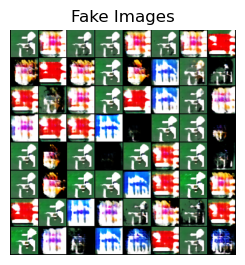

[239/500][221/222]	Loss_D: 0.7141	Loss_G: 0.6855	D(x): 0.9970	D(G(z)): 0.5063 / 0.5063


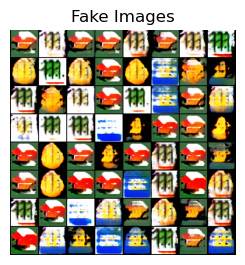

[240/500][221/222]	Loss_D: 0.6768	Loss_G: 0.7147	D(x): 0.9972	D(G(z)): 0.4898 / 0.4898


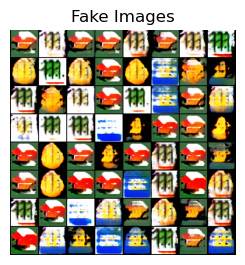

[241/500][221/222]	Loss_D: 0.7357	Loss_G: 0.6569	D(x): 0.9992	D(G(z)): 0.5194 / 0.5194


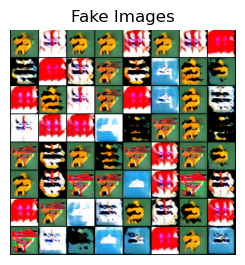

[242/500][221/222]	Loss_D: 0.6768	Loss_G: 0.7161	D(x): 0.9985	D(G(z)): 0.4899 / 0.4899


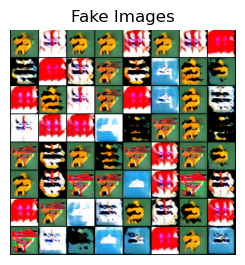

[243/500][221/222]	Loss_D: 0.6791	Loss_G: 0.7111	D(x): 0.9994	D(G(z)): 0.4919 / 0.4919


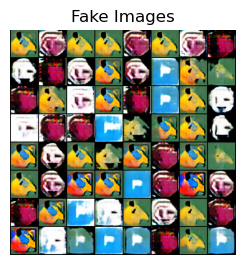

[244/500][221/222]	Loss_D: 0.6629	Loss_G: 0.7326	D(x): 0.9975	D(G(z)): 0.4821 / 0.4821


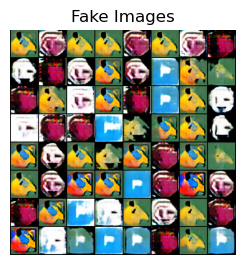

[245/500][221/222]	Loss_D: 0.7218	Loss_G: 0.6742	D(x): 0.9997	D(G(z)): 0.5120 / 0.5120


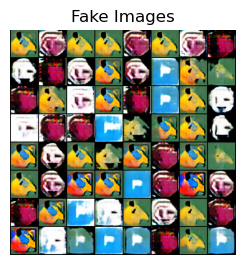

[246/500][221/222]	Loss_D: 0.6549	Loss_G: 0.7338	D(x): 1.0000	D(G(z)): 0.4803 / 0.4803


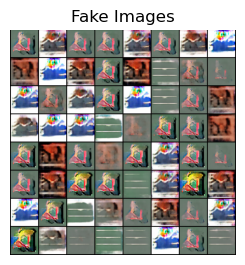

[247/500][221/222]	Loss_D: 0.7106	Loss_G: 0.6762	D(x): 0.9999	D(G(z)): 0.5086 / 0.5086


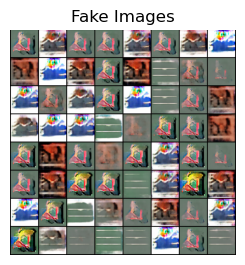

[248/500][221/222]	Loss_D: 0.6707	Loss_G: 0.7163	D(x): 0.9999	D(G(z)): 0.4886 / 0.4886


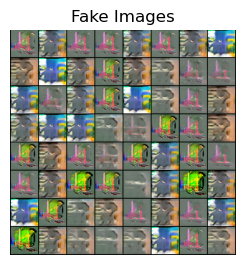

[249/500][221/222]	Loss_D: 0.7715	Loss_G: 0.6211	D(x): 0.9999	D(G(z)): 0.5375 / 0.5375


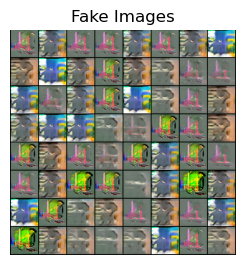

[250/500][221/222]	Loss_D: 0.7215	Loss_G: 0.6660	D(x): 0.9998	D(G(z)): 0.5138 / 0.5138


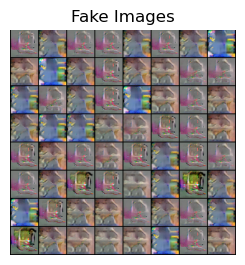

[251/500][221/222]	Loss_D: 0.6952	Loss_G: 0.6913	D(x): 0.9999	D(G(z)): 0.5010 / 0.5010


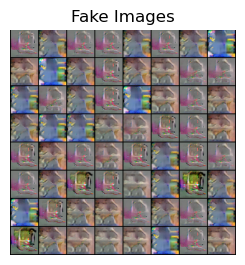

[252/500][221/222]	Loss_D: 0.7398	Loss_G: 0.6495	D(x): 1.0000	D(G(z)): 0.5225 / 0.5225


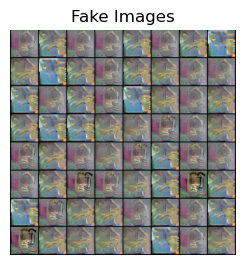

[253/500][221/222]	Loss_D: 0.7125	Loss_G: 0.6744	D(x): 1.0000	D(G(z)): 0.5095 / 0.5095


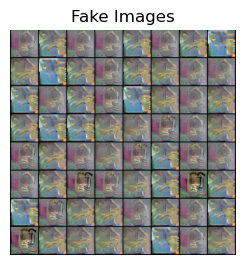

[254/500][221/222]	Loss_D: 0.7146	Loss_G: 0.6722	D(x): 1.0000	D(G(z)): 0.5106 / 0.5106


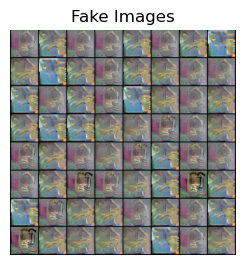

[255/500][221/222]	Loss_D: 0.7477	Loss_G: 0.6419	D(x): 1.0000	D(G(z)): 0.5264 / 0.5264


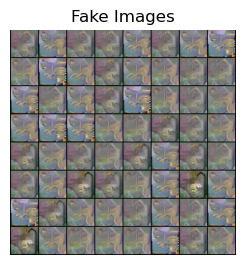

[256/500][221/222]	Loss_D: 0.6865	Loss_G: 0.7000	D(x): 0.9999	D(G(z)): 0.4966 / 0.4966


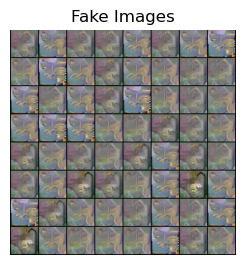

[257/500][221/222]	Loss_D: 0.7256	Loss_G: 0.6617	D(x): 1.0000	D(G(z)): 0.5160 / 0.5160


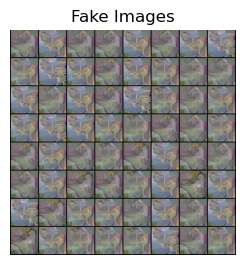

[258/500][221/222]	Loss_D: 0.5853	Loss_G: 0.8147	D(x): 0.9999	D(G(z)): 0.4429 / 0.4429


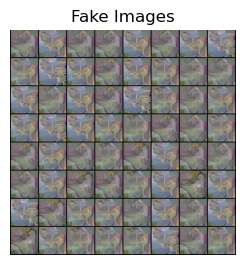

[259/500][221/222]	Loss_D: 0.6857	Loss_G: 0.7008	D(x): 1.0000	D(G(z)): 0.4962 / 0.4962


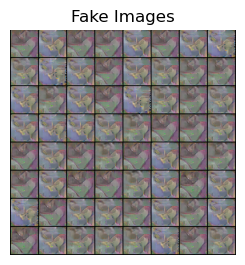

[260/500][221/222]	Loss_D: 0.7015	Loss_G: 0.6850	D(x): 1.0000	D(G(z)): 0.5041 / 0.5041


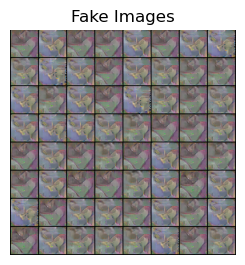

[261/500][221/222]	Loss_D: 0.6821	Loss_G: 0.7044	D(x): 1.0000	D(G(z)): 0.4944 / 0.4944


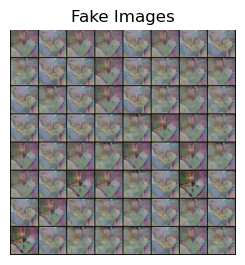

[262/500][221/222]	Loss_D: 0.6969	Loss_G: 0.6899	D(x): 1.0000	D(G(z)): 0.5017 / 0.5017


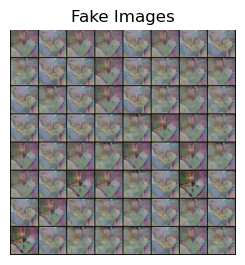

[263/500][221/222]	Loss_D: 0.6930	Loss_G: 0.6933	D(x): 1.0000	D(G(z)): 0.4999 / 0.4999


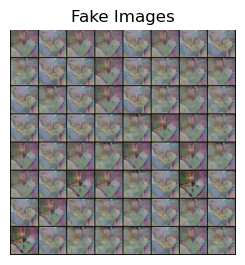

[264/500][221/222]	Loss_D: 0.7634	Loss_G: 0.6276	D(x): 1.0000	D(G(z)): 0.5339 / 0.5339


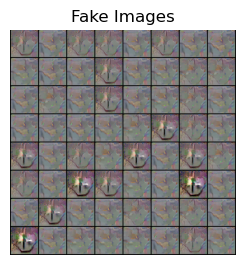

[265/500][221/222]	Loss_D: 0.7000	Loss_G: 0.6864	D(x): 1.0000	D(G(z)): 0.5034 / 0.5034


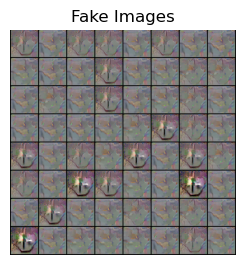

[266/500][221/222]	Loss_D: 0.6587	Loss_G: 0.7289	D(x): 1.0000	D(G(z)): 0.4825 / 0.4825


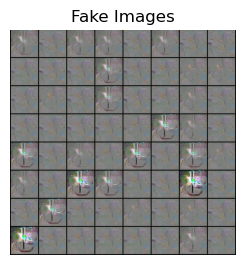

[267/500][221/222]	Loss_D: 0.6548	Loss_G: 0.7331	D(x): 1.0000	D(G(z)): 0.4804 / 0.4804


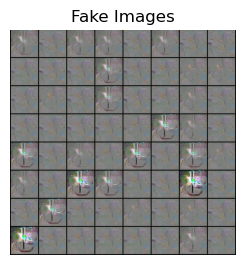

[268/500][221/222]	Loss_D: 0.6803	Loss_G: 0.7063	D(x): 1.0000	D(G(z)): 0.4935 / 0.4935


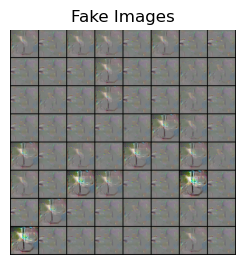

[269/500][221/222]	Loss_D: 0.7123	Loss_G: 0.6744	D(x): 1.0000	D(G(z)): 0.5095 / 0.5095


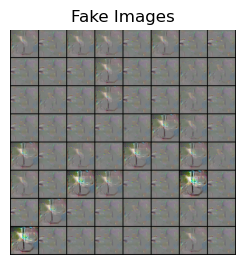

[270/500][221/222]	Loss_D: 0.6831	Loss_G: 0.7035	D(x): 1.0000	D(G(z)): 0.4949 / 0.4949


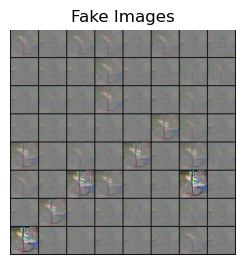

[271/500][221/222]	Loss_D: 0.7058	Loss_G: 0.6808	D(x): 1.0000	D(G(z)): 0.5062 / 0.5062


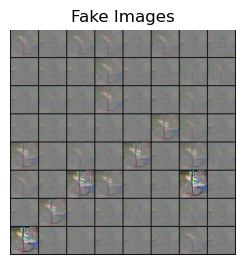

[272/500][221/222]	Loss_D: 0.6958	Loss_G: 0.6906	D(x): 1.0000	D(G(z)): 0.5013 / 0.5013


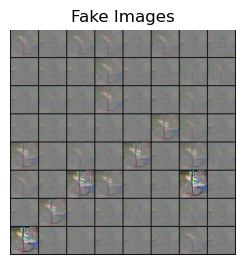

[273/500][221/222]	Loss_D: 0.7371	Loss_G: 0.6511	D(x): 1.0000	D(G(z)): 0.5215 / 0.5215


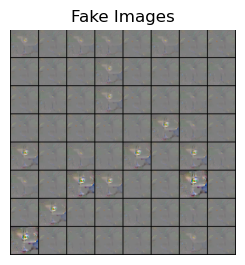

[274/500][221/222]	Loss_D: 0.6958	Loss_G: 0.6905	D(x): 1.0000	D(G(z)): 0.5013 / 0.5013


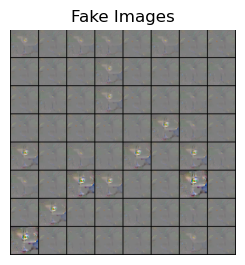

[275/500][221/222]	Loss_D: 0.7371	Loss_G: 0.6511	D(x): 1.0000	D(G(z)): 0.5215 / 0.5215


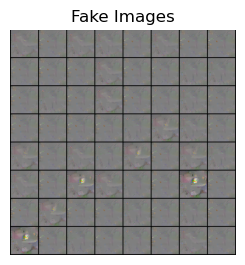

[276/500][221/222]	Loss_D: 1.1592	Loss_G: 0.4503	D(x): 0.9021	D(G(z)): 0.6417 / 0.6417


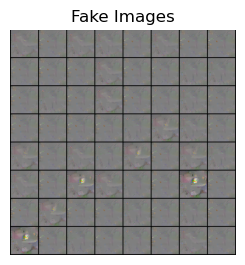

KeyboardInterrupt: 

In [27]:
print("Starting Training Loop...")
num_epochs = 500
already_completed = 54
# For each epoch
for epoch in range(1, 1+num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        discriminator.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = discriminator(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, 100, 1, 1, device=device)
        # Generate fake image batch with G
        fake = generator(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = discriminator(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        generator.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = discriminator(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # # Output training stats
        # if i % 400 == 0:
        #     print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
        #           % (epoch, num_epochs, i, len(dataloader),
        #              errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = generator(fixed_noise).detach().cpu()
            img_list.append(torchvision.utils.make_grid(fake, padding=2, normalize=True))
        iters += 1

    print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
            % (epoch, num_epochs, i, len(dataloader),
            errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
    
    save(r"D:\Python\gan\models\\" + str(already_completed+epoch) + "_epochs.pt")

    # Plot the fake images from the last epoch
    plt.subplot(1,2,2)
    plt.axis("off")
    plt.title("Fake Images")
    plt.imshow(np.transpose(img_list[-1],(1,2,0)))
    plt.show()



In [25]:
load(r'D:\Python\gan\models\4_epochs.pt')

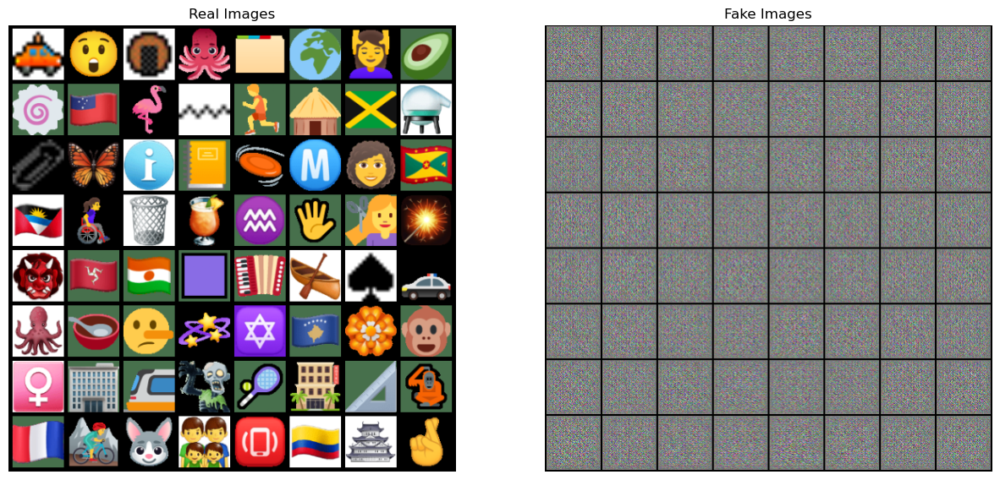

In [17]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(torchvision.utils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

generator = generator.to(torch.device('cpu'))
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(torchvision.utils.make_grid(generator(torch.randn(64, 100, 1, 1)), padding=2, normalize=True),(1,2,0)))
generator = generator.to(torch.device("cuda" if torch.cuda.is_available() else "cpu"))
plt.show()

